In [1]:
%load_ext autoreload
%autoreload 2
#python v3.11.3

In [2]:

import warnings
#to suppress seaborn palette warnings
warnings.filterwarnings("ignore", category=UserWarning)
#to suppress seaborn error estimation NaN warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)

import os
import datetime

import numpy as np #v1.25.0
import pandas as pd #v2.0.3

import scipy #v1.10.1
import scipy.stats as stats
from scipy.optimize import curve_fit

import seaborn as sns #v0.13.0
import matplotlib as mpl #v3.8.1
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.dates as mdates

from matplotlib.patches import Rectangle
from matplotlib.collections import LineCollection


# these files should be in the same directory as this Jupyter notebook
from format_arduino_data import *
from lickfrequency_analysis import *
from plot_data import *

# to set styles for plotting
mpl.style.use(r"C:\Users\swind\Documents\lab_work\Barth\behavior_analysis\mouse_analysis\full_trial_analysis\mouse_analysis.mplstyle")

#to suppress inaccurate pandas reassignment warnings
pd.options.mode.chained_assignment = None  # default='warn'

### Load data

In [3]:
def load_data(path, data_type, data_name, conds, dtype_map, cols):
    dataset  = []
    cols = cols.copy()
    for cond in conds:
        o_data = pd.read_csv(path + cond + '\\' + data_type + '_' + cond + '_' + data_name + '.txt', dtype=dtype_map)
        rm = []
        for c in cols:
            if c not in o_data.columns:
                rm.append(c)
        for c in rm:
            cols.remove(c)
        o_data = o_data[cols]
        dataset.append(o_data)
    dataset = pd.concat(dataset)
    dataset = dataset.replace({pd.NA:'u'})
    return dataset

def format_strain(df):
    df.loc[(df['Strain'] == 'SSTcre/Ai32-')|(df['Strain'] == 'Sscre x Ai32 -'), 'Strain'] = 'SSTcre x Ai32-'
    df.loc[(df['Strain'] == 'SSTcre x Ai32')|(df['Strain'] == 'Sscre x Ai32'), 'Strain'] = 'SSTcre x Ai32'
    df.loc[(df['Strain'] == 'SSTcre')|(df['Strain'] == 'Sscre'), 'Strain'] = 'SSTcre'
    df.loc[(df['Strain']=='Scnn-cre')|(df['Strain']=='Scnn-cre + 6OHDA')|(df['Strain']=='Scnn-cre+6OHDA partial'), 'Strain'] = 'Scnn-cre'
    df.loc[(df['Strain']=='.1-3/sscre'), 'Strain'] = '.1-3 x SSTcre'
    df.loc[df['Strain'] == '1-3 x Scnn-cre (1-3 WT)', 'Strain'] = '.1-3- x Scnn-cre'
    df.loc[df['Strain'] == '1-3 x Scnn-cre (1-3 Het)', 'Strain'] = '.1-3+ x Scnn-cre'

def format_condition(df):
    df["cond"] = df["condition"].replace({"hm4di_cno": "hM4Di + CNO", "mcherry_cno": "mCherry + CNO", 
                            '0.1 mg DCZ hm4di': "hM4Di + DCZ", 
                            '0.1 mg DCZ mcherry': "mCherry + DCZ", 
                            '0.5 mg DCZ mcherry':"mCherry + DCZ",  
                            '0.5 mg DCZ hm4di': "hM4Di + DCZ",
                            '100acc80acc':'100ACC80ACC',
                            "all_reward": "100ACC80SAT",
                            "SAT": "SAT", 'sat1':'SAT', 'sat5':'SAT', 
                            'SAT1':'SAT', 'SAT2':'SAT','SAT5':'SAT',
                            'acc2':'ACC', 'acc3':'ACC', 'acc7':'ACC',
                            'Ipsi-lesion':'Ipsi-lesion', 
                            'Contra-lesion':'Contra-lesion'})
    df['test_time'] = 'train'
    df.loc[df['condition'].str.contains('train'), 'cond'] = df.loc[df['condition'].str.contains('train'), 'condition'].str.rstrip('retrain').str.rstrip(' ')
    df.loc[df['condition'].str.contains('ipsi'), 'cond'] = 'ipsi lesion'
    df.loc[df['condition'].str.contains('sham'), 'cond'] = 'sham lesion'
    df.loc[df['condition'].str.contains('train'), 'test_time'] = df.loc[df['condition'].str.contains('train'), 'condition'].str.lstrip('contrlaipshm').str.lstrip(' ').str.lstrip('lesion').str.lstrip(' ')
    df.loc[df['test_time'].str.contains('retrain'), 'test_time'] = '5d test'
    df.loc[df['condition'].str.contains('test'), 'cond'] = df.loc[df['condition'].str.contains('test'), 'condition'].str.rstrip('test').str.rstrip(' ')
    df.loc[df['condition'].str.contains('test'), 'test_time'] = '21d test'

def format_cage(df):
    df['Cage'] = df['Cage'].str.upper()
    df.loc[df['Cage'] == 'UNKNOWN', 'Cage'] = 'U'
    df.loc[df['Cage'].isna(), 'Cage'] = 'U'

def format_all(df):
    if df['Day'].all():
        df['Day'] = df['Day'].apply(day_to_label)
    format_cage(df)
    format_strain(df)
    format_condition(df)

In [4]:
dtype_map = {'condition':str,'animal':str, 'stimulus':str, 'lick':float, 'Strain':str, 'Cage':str, 'type':str, 'Time (ms)':float, 'Time (hr)':float, 'Day':float, 'water':str}
perf_cols = ['condition', 'animal', 'Strain', 'Age', 'Cage', 'Date', 'acc', 'Time (hr)', 'Day']
lf_cols = perf_cols + ['stimulus', 'water', 'type']
conds = ['retrain']
data_path = 'C:\\Users\\swind\\Documents\\lab_work\\Barth\\behavior_analysis\\behavior_data\\analyzed\\'
to_load = {'full means':'', 'full performance':'', 'anticipatory means':'', 'anticipatory performance':'',
           'anticipatory trial_counts':'', 'anticipatory trials_summed_day':'', 'last20 means':''}
for type_name in to_load:
    data_type, data_name = type_name.split(' ')
    val = ['trial no'] if 'trial' in data_name else ['lick']
    cols = perf_cols if 'performance' in data_name else lf_cols
    ms = ['Time (ms)']  if 'full' in data_type else []
    to_load[type_name] = load_data(data_path, data_type, data_name, conds, dtype_map, cols + ms + val)
    format_all(to_load[type_name])

means_full = to_load['full means']
trials_day = to_load['anticipatory trials_summed_day']
perf_full = to_load['full performance']
ant_perf = to_load['anticipatory performance']
ant_means = to_load['anticipatory means']
trials = to_load['anticipatory trial_counts']
last20_means = to_load['last20 means']

In [5]:
format_all(ant_perf)
format_all(ant_means)
format_all(perf_full)
format_all(means_full)

In [6]:
ant_means['animal'] = ant_means['animal'].str.rstrip('retraintest ')
ant_perf['animal'] = ant_perf['animal'].str.rstrip('retraintest ')
perf_full['animal'] = perf_full['animal'].str.rstrip('retraintest ')
means_full['animal'] = means_full['animal'].str.rstrip('retraintest ')
trials['animal'] = trials['animal'].str.rstrip('retraintest ')

In [7]:
trials_day['Day'] = trials_day['Day'].apply(day_to_label)

In [8]:
ant_means['Time (hr)'] = ant_means['Time (hr)'] + 2
ant_perf['Time (hr)'] = ant_perf['Time (hr)'] + 2
trials['Time (hr)'] = trials['Time (hr)'] + 2

In [9]:
# sum number of stimulus and blank trials together
tots = sum_trials(trials, ['condition', 'animal', 'Time (hr)'], ['Age','Strain', 'Date', 'Cage', 'Day'], "trial no")
format_all(tots)

In [10]:
ant_means_cond = ant_means[((ant_means['test_time'] == 'train') & (ant_means['Time (hr)'] < 48) & ((ant_means['Time (hr)'] >= -24))) 
                          |(((ant_means['test_time'] == '5d test') |  (ant_means['test_time'] == '21d test')) 
                             & (ant_means['Time (hr)'] < 48) & ((ant_means['Time (hr)'] >= 0)))]
ant_perf_cond = ant_perf[((ant_perf['test_time'] == 'train') & (ant_perf['Time (hr)'] < 48) & ((ant_perf['Time (hr)'] >= -24))) 
                          |(((ant_perf['test_time'] == '5d test') |  (ant_perf['test_time'] == '21d test')) 
                             & (ant_perf['Time (hr)'] < 48) & ((ant_perf['Time (hr)'] >= 0)))]
tots_cond = tots[((tots['test_time'] == 'train') & (tots['Time (hr)'] < 48) & ((tots['Time (hr)'] >= -24))) 
                          |(((tots['test_time'] == '5d test') |  (tots['test_time'] == '21d test')) 
                             & (tots['Time (hr)'] < 48) & ((tots['Time (hr)'] >= 0)))]

In [11]:
ant_means_cond.loc[ant_means_cond['condition'].str.contains('retrain'), 'Time (hr)'] += 48 + 24
ant_means_cond.loc[ant_means_cond['condition'].str.contains('test'), 'Time (hr)'] += 48 + 48 + 24 + 24

ant_perf_cond.loc[ant_perf_cond['condition'].str.contains('retrain'), 'Time (hr)'] += 48 + 24
ant_perf_cond.loc[ant_perf_cond['condition'].str.contains('test'), 'Time (hr)'] += 48 + 48 + 24 + 24

tots_cond.loc[tots_cond['condition'].str.contains('retrain'), 'Time (hr)'] += 48 + 24
tots_cond.loc[tots_cond['condition'].str.contains('test'), 'Time (hr)'] += 48 + 48 + 24 + 24

In [12]:
ylim = [-0.1, 10]
xlim = [-24, 192]
xticklab = ['', -24, -12, 0, 12, 24, 36, 48, '', 0, 12, 24, 36, 48, '', 0, 12, 24, 36, 48]

#### last and first 20%

In [13]:
data_path = 'C:\\Users\\swind\\Documents\\lab_work\\Barth\\behavior_analysis\\behavior_data\\analyzed\\'
cols =  ['condition', 'animal', 'Strain', 'Age', 'Cage','Date', 'Day', 'Time (hr)', 'lick']
conds = ['eunsol', 'dcz', 'joe', 'retrain', 'lesion']
last20_perf = load_data(data_path, 'last20', 'performance', conds, dtype_map, cols)
format_all(last20_perf)
last20_perf

,condition,animal,Strain,Age,Cage,Date,Day,Time (hr),lick,cond,test_time
0,100acc80acc,PNL1,.1-3 x SSTcre,27.0,PIPLUP,u,-2.0,-36.0,0.487734,100ACC80ACC,train
1,100acc80acc,PNL1,.1-3 x SSTcre,27.0,PIPLUP,u,-1.0,-12.0,0.087719,100ACC80ACC,train
2,100acc80acc,PNL1,.1-3 x SSTcre,27.0,PIPLUP,u,0.0,12.0,0.063706,100ACC80ACC,train
3,100acc80acc,PNL2,.1-3 x SSTcre,27.0,SUSHI,u,-2.0,-36.0,-1.204082,100ACC80ACC,train
4,100acc80acc,PNL2,.1-3 x SSTcre,27.0,SUSHI,u,-1.0,-12.0,-2.216425,100ACC80ACC,train
...,...,...,...,...,...,...,...,...,...,...,...
135,Contra-lesion,210723 KEI_2m True_contra,u,NaN,TRUE,210723,0.0,16.0,-0.940171,Contra-lesion,train
136,Contra-lesion,210723 KEI_2m True_contra,u,NaN,TRUE,210723,1.0,40.0,3.710991,Contra-lesion,train
137,Contra-lesion,210723 KEI_2m True_contra,u,NaN,TRUE,210723,2.0,64.0,4.792546,Contra-lesion,train
138,Contra-lesion,210723 KEI_2m True_contra,u,NaN,TRUE,210723,3.0,88.0,3.639307,Contra-lesion,train


In [14]:
data_path = 'C:\\Users\\swind\\Documents\\lab_work\\Barth\\behavior_analysis\\behavior_data\\analyzed\\'
cols =  ['condition', 'animal', 'Strain', 'Age', 'Cage','Date', 'Day','stimulus', 'water', 'type', 'Time (hr)', 'lick', 'day_delta', 'trial no', 'delta']
conds = ['retrain']
ant_data = load_data(data_path, 'anticipatory', 'data', conds, dtype_map, cols)
last20_data = load_data(data_path, 'last20', 'data', ['retrain'], dtype_map, cols)

In [15]:
keys = {
        "millis bin":None,
        "Time (ms)":"Time (ms)",
        "stimulus type":"stimulus",
        "water delivery":"water",
        "trial no":"trial no",
        "time bin":"day_delta",
        "licks":"lick",
        "timestamp":"timestamp",
        "delay":"delay",
        "acc":"acc",
        'offset':'offset'
    }

In [16]:
first20 = get_nth_part_day(ant_data, 5, 1)
keep = ['Strain', 'Age', 'Cage','Date', 'Day', 'trial no', 'stimulus', 'water', 'type', 'Time (hr)']
first20_means, first20_counts, first20_perf = agg(first20, keys, ['condition', 'animal'], keep, ['lick'])

format_all(first20_means)
format_all(first20_perf)
first20_means

,condition,animal,day_delta,stimulus,lick,Strain,Age,Cage,Date,Day,trial no,type,Time (hr),water,cond,test_time
0,contra lesion retrain,PB715 retrain,0 days,blank,1.805556,C57,51.0,CHICAGO,2024-04-13,0.0,1,no water & blank,0.0,no water,contra lesion,5d test
1,contra lesion retrain,PB715 retrain,0 days,stimulus,2.057971,C57,51.0,CHICAGO,2024-04-13,0.0,2,water & stimulus,0.0,water,contra lesion,5d test
2,contra lesion retrain,PB715 retrain,1 days,blank,4.400000,C57,51.0,CHICAGO,2024-04-13,1.0,701,no water & blank,24.0,no water,contra lesion,5d test
3,contra lesion retrain,PB715 retrain,1 days,stimulus,4.105263,C57,51.0,CHICAGO,2024-04-13,1.0,696,water & stimulus,24.0,water,contra lesion,5d test
4,contra lesion retrain,PB715 retrain,2 days,blank,3.043478,C57,51.0,CHICAGO,2024-04-13,2.0,1306,no water & blank,48.0,no water,contra lesion,5d test
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
548,sham lesion train,PWH9 train,0 days,stimulus,2.088889,C57,40.0,PIPLUP,2024-04-23,0.0,386,water & stimulus,0.0,water,sham lesion,train
549,sham lesion train,PWH9 train,1 days,blank,3.076923,C57,40.0,PIPLUP,2024-04-23,1.0,857,no water & blank,24.0,no water,sham lesion,train
550,sham lesion train,PWH9 train,1 days,stimulus,4.553991,C57,40.0,PIPLUP,2024-04-23,1.0,853,water & stimulus,24.0,water,sham lesion,train
551,sham lesion train,PWH9 train,2 days,blank,0.000000,C57,40.0,PIPLUP,2024-04-23,2.0,1276,no water & blank,48.0,no water,sham lesion,train


In [17]:
first20_means['time'] = 'first 20%'
last20_means['time'] = 'last 20%'

first20_perf['time'] = 'first 20%'
last20_perf['time'] = 'last 20%'

firstlast20_means = pd.concat([first20_means, last20_means])
firstlast20_perf = pd.concat([first20_perf, last20_perf])

# drop times that are missing values
firstlast20_means = firstlast20_means.set_index(['animal', 'Day','time'])
firstlast20_means = firstlast20_means[firstlast20_means.groupby(['animal', 'Day', 'time']).count()['lick'] == 2]
firstlast20_means = firstlast20_means.reset_index()
firstlast20_perf = firstlast20_perf[~(firstlast20_perf['lick'].isna())]

firstlast20_means['animal'] = firstlast20_means['animal'].str.rstrip('retraintest ')
firstlast20_perf['animal'] = firstlast20_perf['animal'].str.rstrip('retraintest ')

In [18]:
firstlast20_means['Day_label'] = firstlast20_means["Day"].apply(day_to_label)
firstlast20_perf['Day_label'] = firstlast20_perf["Day"].apply(day_to_label)

firstlast20_means['daytime'] = firstlast20_means['Day_label'] + ' ' + firstlast20_means['time']
firstlast20_perf['daytime'] = firstlast20_perf['Day_label'] + ' ' + firstlast20_perf['time']

firstlast20_means['daytimetest'] = firstlast20_means['daytime'] + ' ' + firstlast20_means['test_time']
firstlast20_perf['daytimetest'] = firstlast20_perf['daytime'] + ' ' + firstlast20_perf['test_time']

In [19]:
days = ['SAT 2 last 20% train', f'SAT 1 first 20% 5d test', f'SAT 2 last 20% 5d test', f'SAT 1 first 20% 21d test', f'SAT 2 last 20% 21d test']
conds = ['control', 'contra lesion', 'sham lesion', 'ipsi lesion']

## Control

In [87]:
ant_means_cond[['cond','test_time', 'animal', 'Time (hr)', 'stimulus', 'water', 'lick']].to_excel(r'C:\Users\swind\Documents\lab_work\Barth\behavior analysis summary\lesion and retraining\retrain_ant_lf.xlsx')
ant_perf_cond[['cond','test_time', 'animal', 'Time (hr)','lick']].to_excel(r'C:\Users\swind\Documents\lab_work\Barth\behavior analysis summary\lesion and retraining\retrain_ant_perf.xlsx')
tots_cond[['cond','test_time', 'animal', 'Time (hr)', 'trial no']].to_excel(r'C:\Users\swind\Documents\lab_work\Barth\behavior analysis summary\lesion and retraining\trial_counts.xlsx')

### Anticipatory lick frequency summary

(<seaborn.axisgrid.FacetGrid at 0x26f320a2090>,
 <seaborn.axisgrid.FacetGrid at 0x26f9fb31450>)

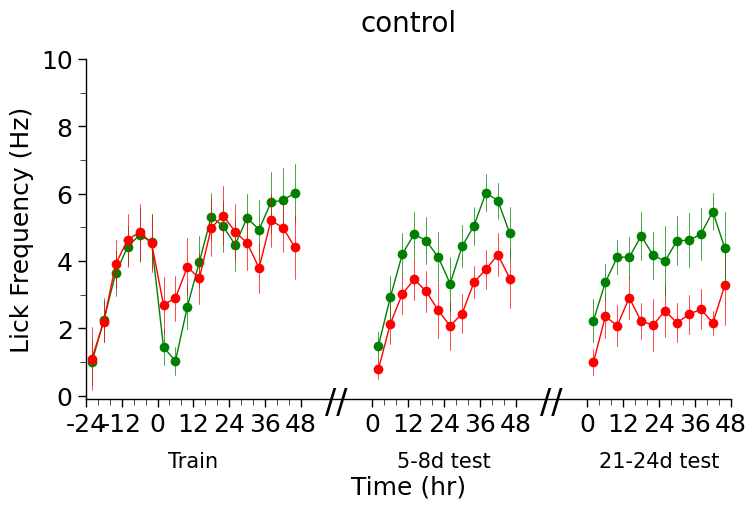

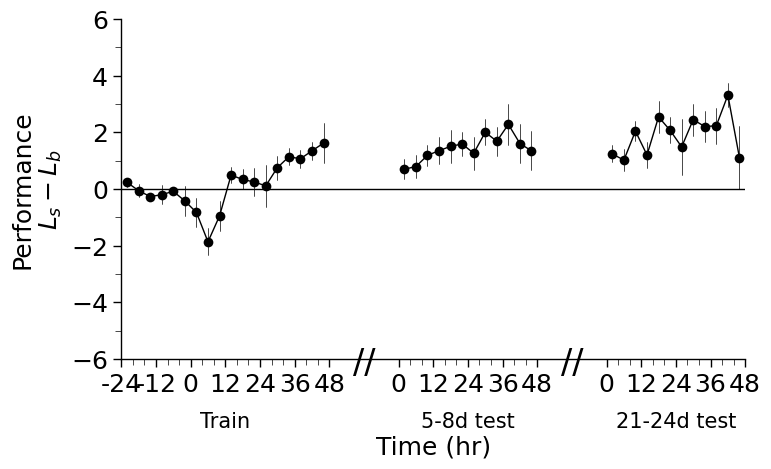

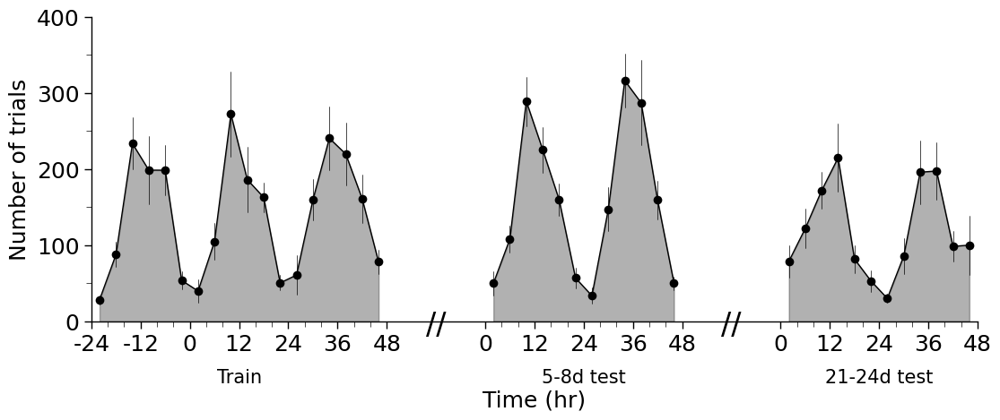

In [40]:
plot_retrain('control', ant_means_cond, ant_perf_cond, tots_cond, [-24, 192], xticklab, aspect=1.5)

### Last 20%

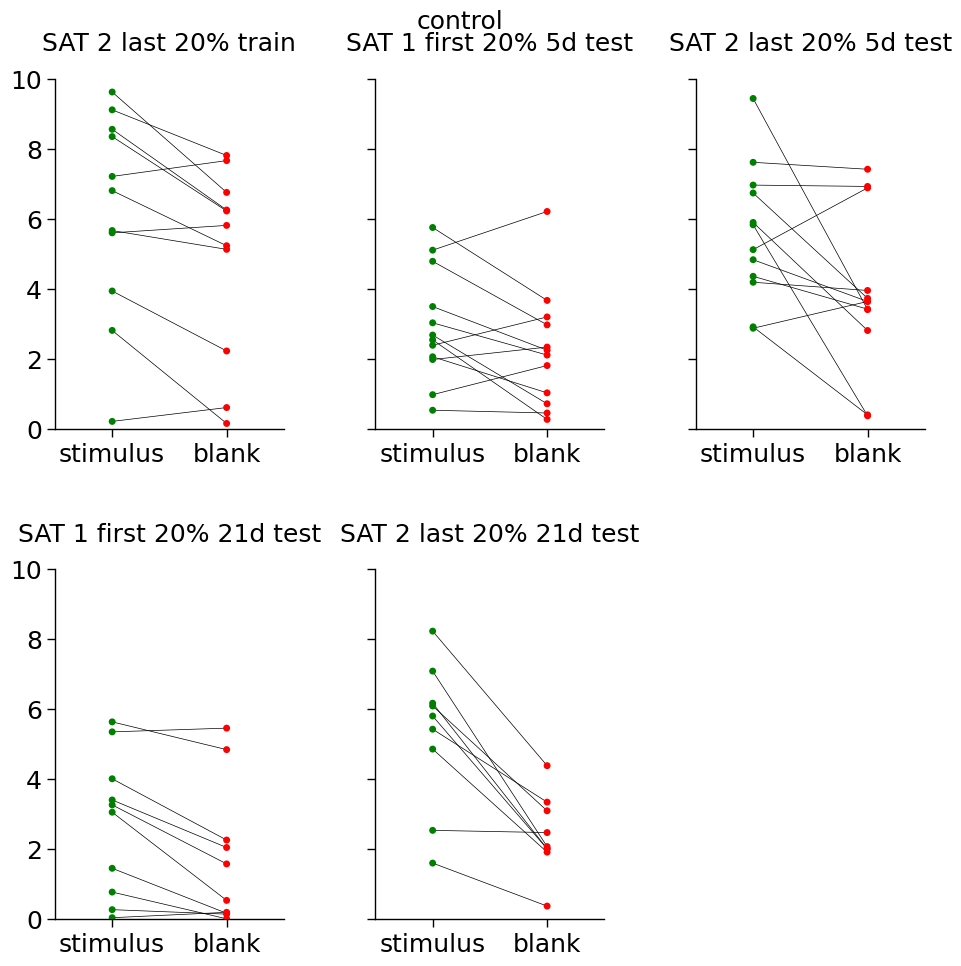

In [21]:
days = ['SAT 2 last 20% train', f'SAT 1 first 20% 5d test', f'SAT 2 last 20% 5d test', f'SAT 1 first 20% 21d test', f'SAT 2 last 20% 21d test']
dayfilt = firstlast20_means[(firstlast20_means.apply(lambda x: x['daytimetest'] in days, axis=1))]
cdfilt = dayfilt[dayfilt["cond"] == 'control']

g = plot_pair_strip(cdfilt, y="lick",x="stimulus", order=["stimulus", "blank"],
                    hue="stimulus", palette=["green", "red"], col_wrap=3,
                    hue_order=["stimulus", "blank"],col_order=days,
                    col="daytimetest", jitter=False, aspect=0.65, legend=False, connect=True)
g.fig.suptitle('control', y=1)
g.fig.subplots_adjust(wspace=0.4, hspace=0.4)

### Instentanteous lick frequency

#### summary

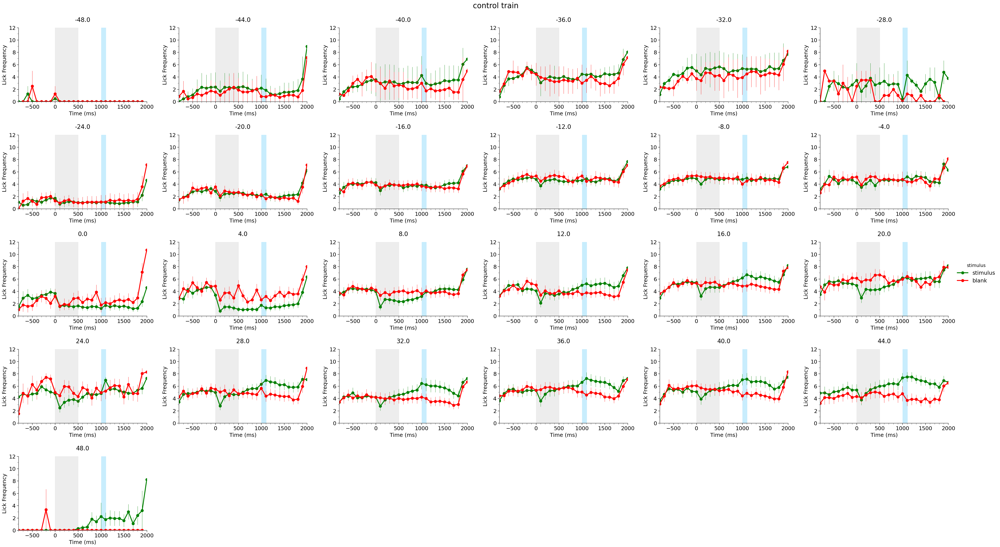

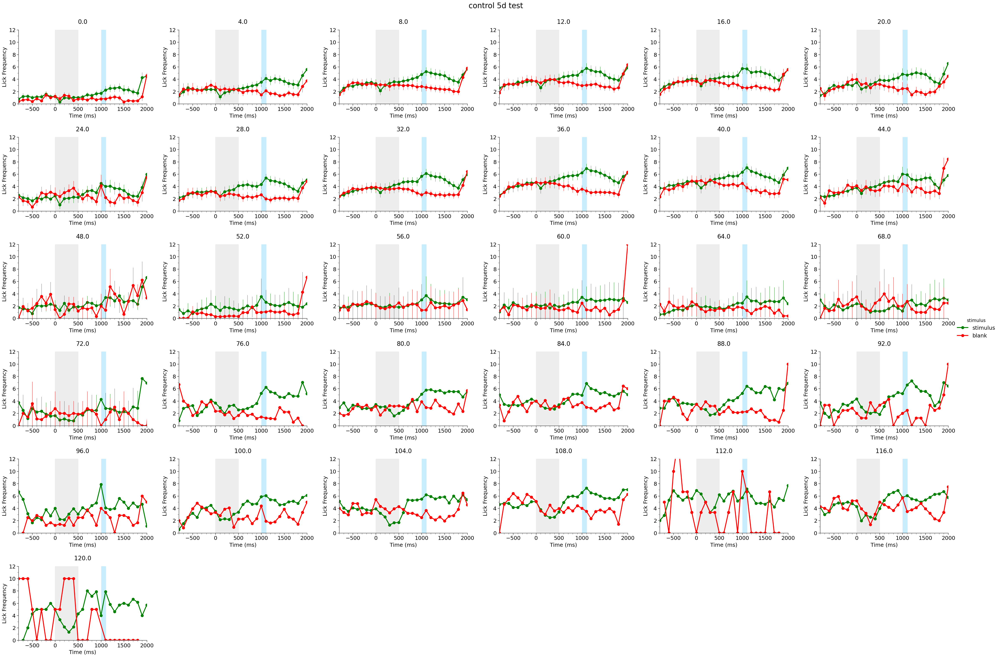

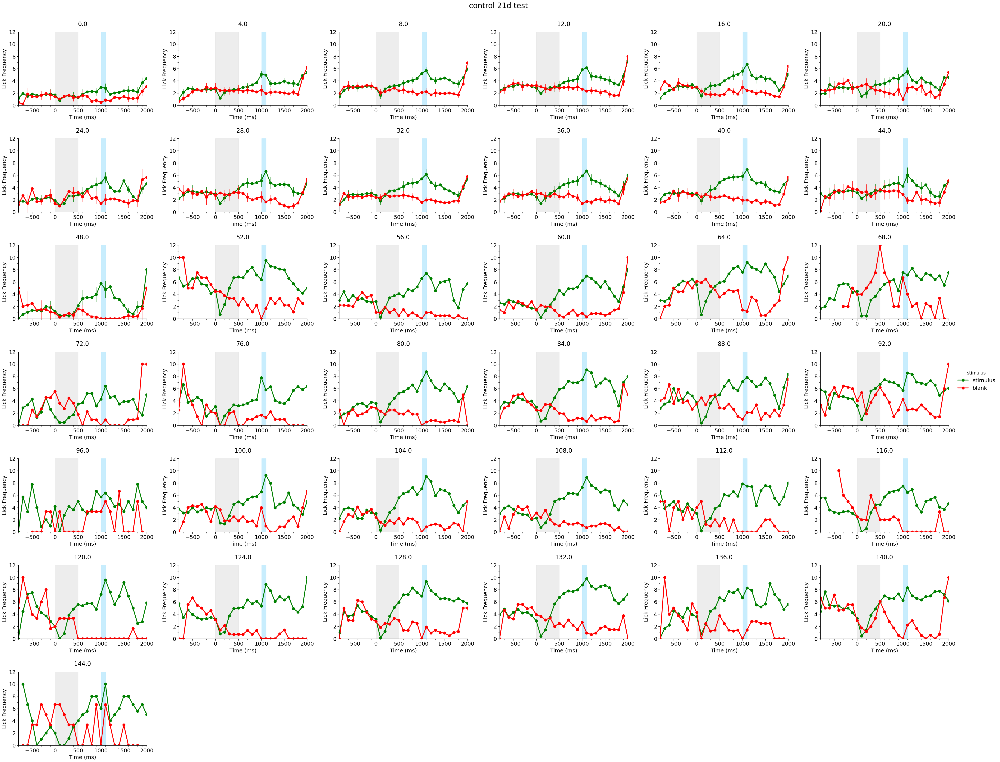

In [22]:
c = 'control'
for tt in means_full[(means_full['cond'] == c)]['test_time'].unique():    
    plot_lickfreq(means_full[(means_full['cond'] == c) & (means_full['test_time'] == tt)], suptitle=f'{c} {tt}',
                col_wrap=6,errorbar='se', err_style='bars', err_kws={'lw':0.7}, xlim=[-800, 2000])

#### by animal

KeyError: 'Time (hr)'

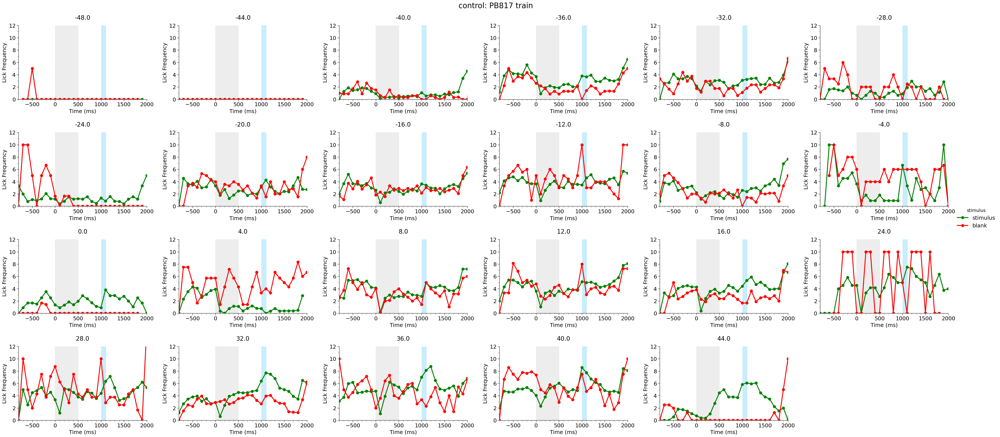

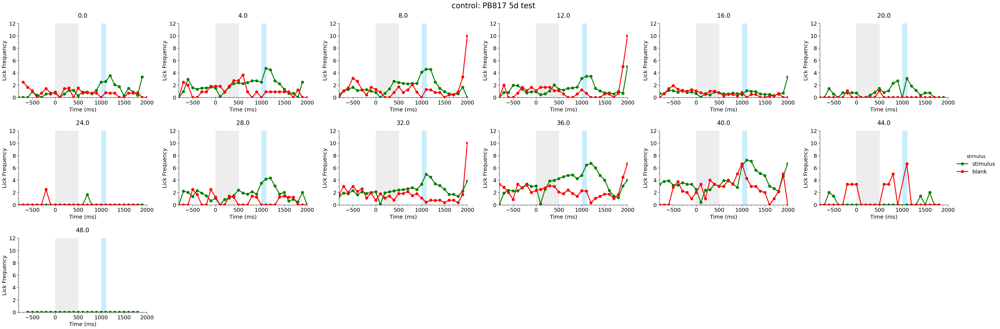

In [23]:
for a in means_full[(means_full['cond'] == 'control')]['animal'].unique():
    for tt in means_full[(means_full['cond'] == 'control')]['test_time'].unique():    
        plot_lickfreq(means_full[(means_full['animal'] == a) & (means_full['test_time'] == tt)], suptitle=f'{c}: {a} {tt}',
                    col_wrap=6,errorbar='se', err_style='bars', err_kws={'lw':0.7}, xlim=[-800, 2000])

### Anticipatory lick frequency by animal

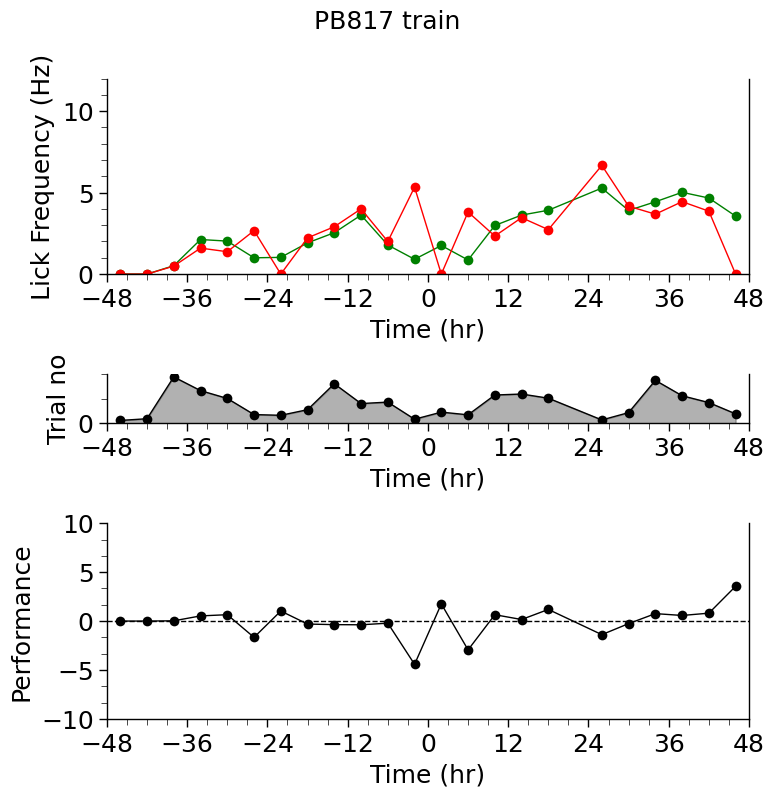

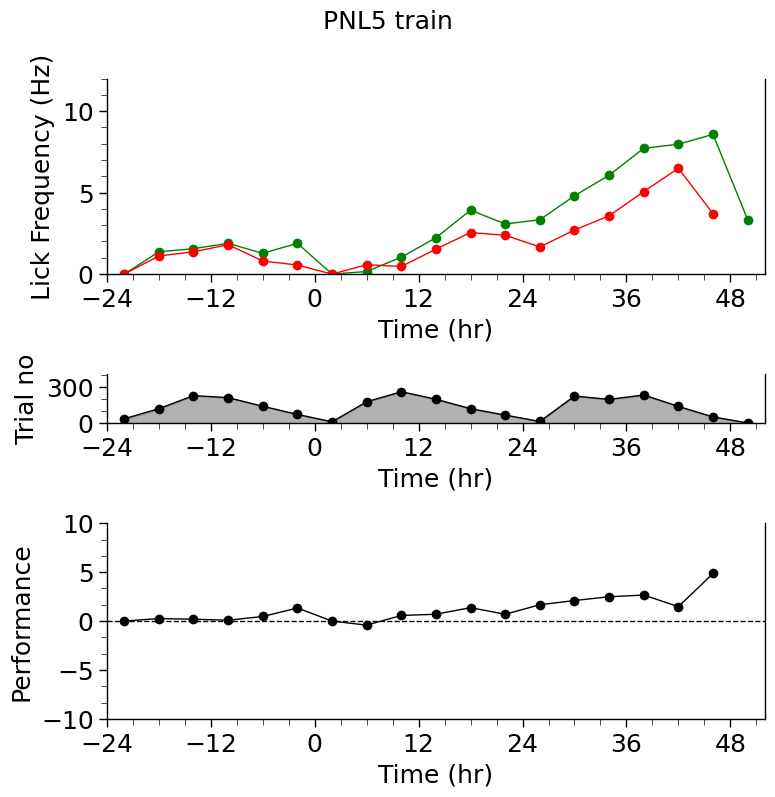

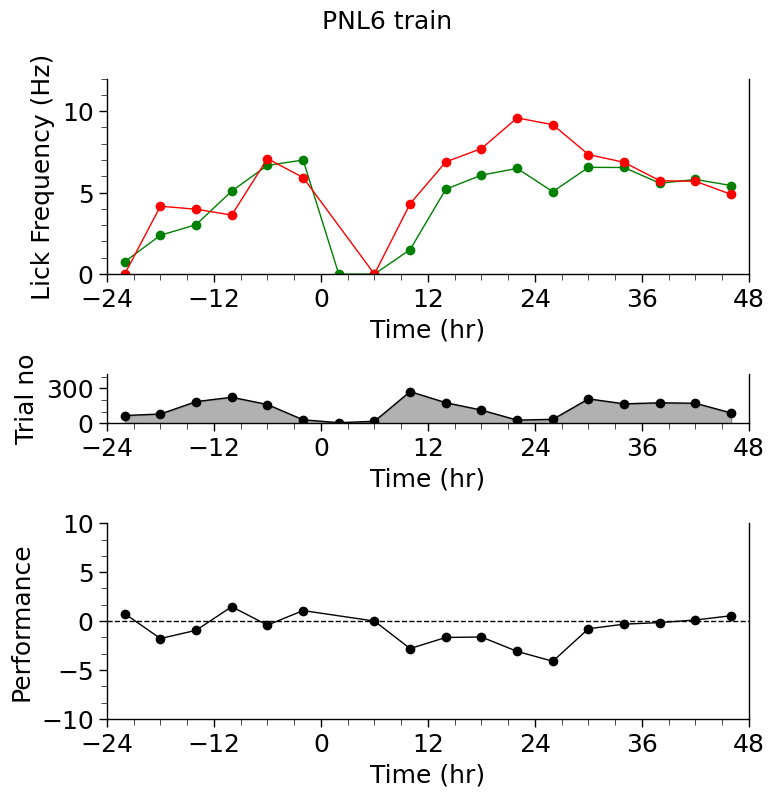

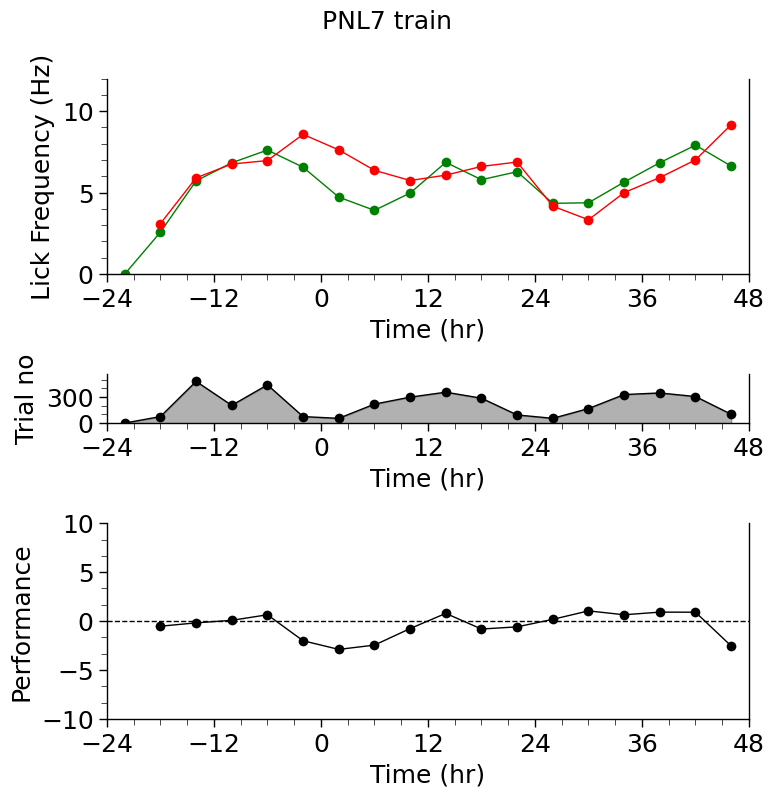

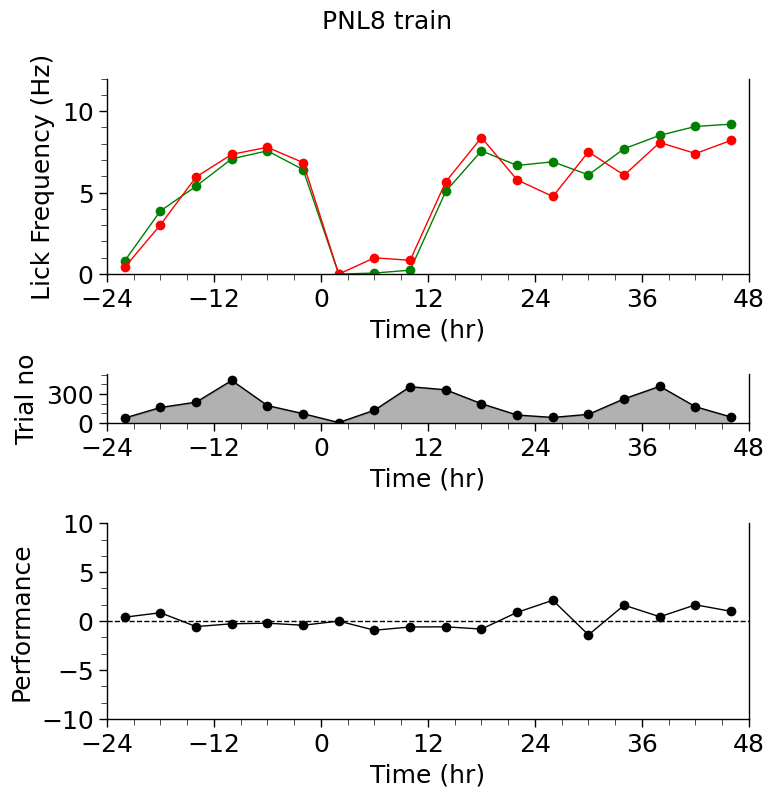

...

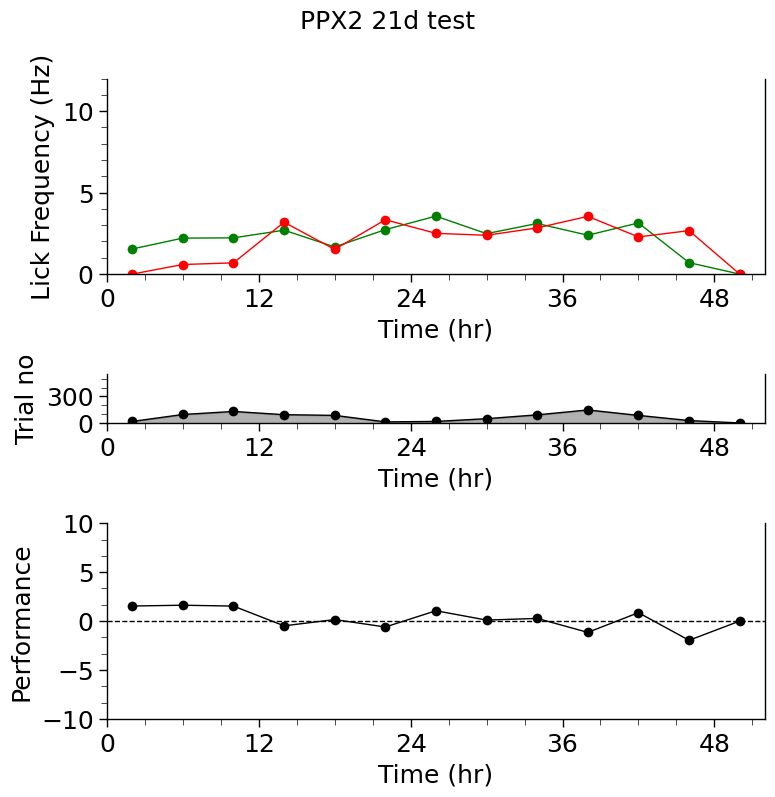

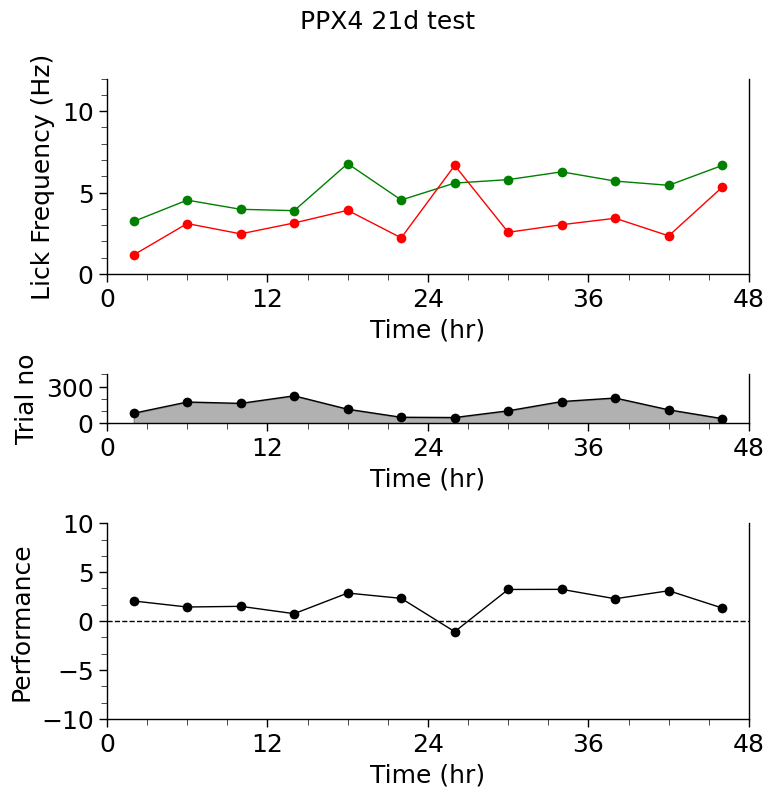

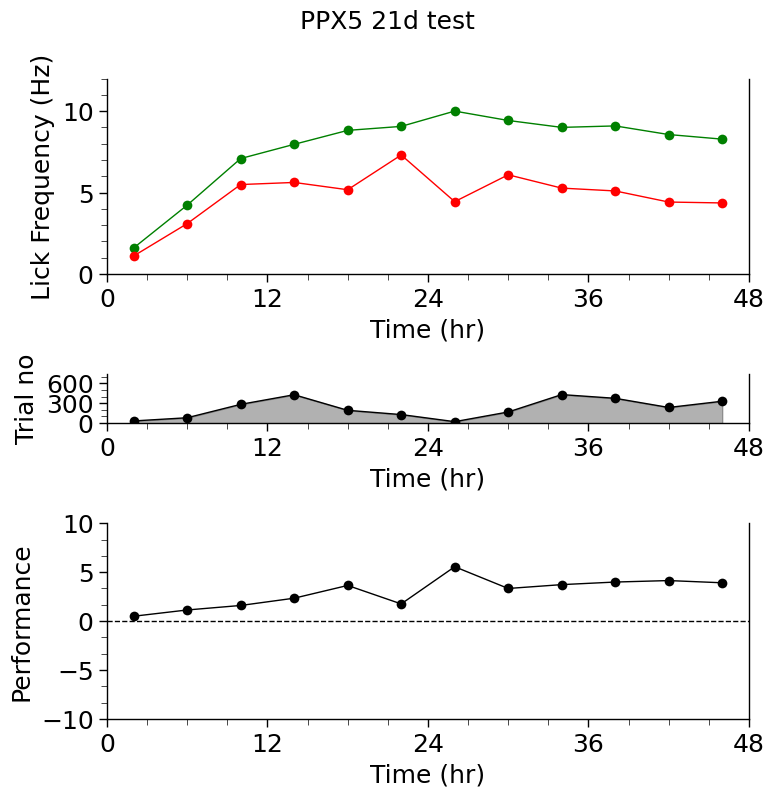

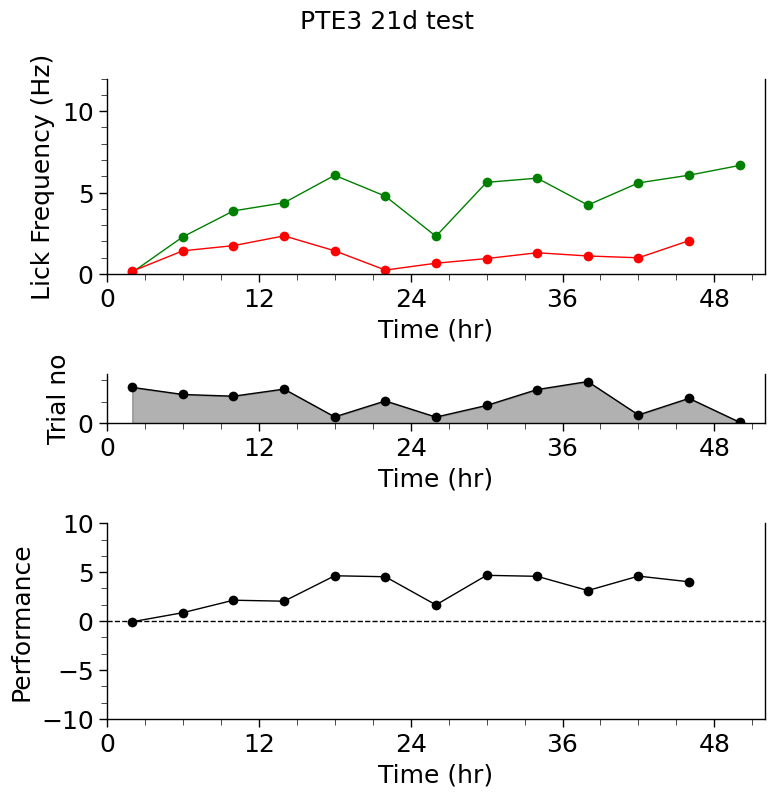

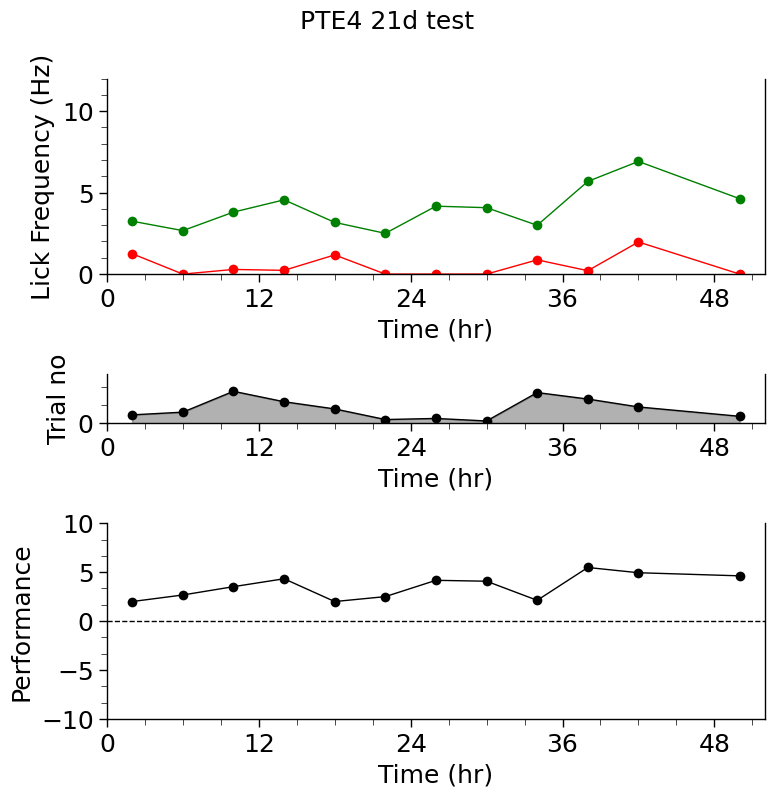

In [24]:
xlim=[-24, 48]
ctmp = ant_means[ant_means['cond'] == 'control']
for tt in ctmp['test_time'].unique():
    tmp = ctmp[ctmp['test_time'] == tt]
    for a in tmp["animal"].unique():
        xlim = [tmp[(tmp["animal"] == a)]["Time (hr)"].min() - 2, tmp[(tmp["animal"] == a)]["Time (hr)"].max() + 2]
        fg, axs = plt.subplots(3,1, height_ratios=[4,1,4], figsize=(8, 8))
        g = sns.lineplot(tmp[(tmp["animal"] == a)],x='Time (hr)',y='lick',linewidth=1, marker='o', mew=0,markersize=7, ax=axs[0],
                legend=False, errorbar='se', err_style='bars', err_kws={"lw":0.5}, hue='stimulus', hue_order=['stimulus', 'blank'],palette=['green', 'red'])
        g = sns.lineplot(ant_perf[(ant_perf["animal"] == a) & (ant_perf['test_time'] == tt)], y='lick',x='Time (hr)',lw=1,marker='o', mew=0, ms=7,ax=axs[2],
                        legend=False,errorbar='se', err_style='bars', err_kws={"lw":0.5}, color='k')
        g = sns.lineplot(tots[(tots["animal"] == a) & (tots['test_time'] == tt)],x='Time (hr)',y='trial no',ax=axs[1],marker='o', mew=0,
                            ms=7, lw=1,err_kws={"lw":0.5}, color='k')
        
        axs[0].set_ylim([0, 12])
        ymal = ticker.MultipleLocator(5)
        ymil = ticker.MultipleLocator(1)
        axs[0].yaxis.set_major_locator(ymal)
        axs[0].yaxis.set_minor_locator(ymil)
        axs[0].set_ylim([0, 12])
        axs[2].set_ylim([-10, 10])
        ymal = ticker.MultipleLocator(5)
        ymil = ticker.MultipleLocator(5/3)
        axs[2].yaxis.set_major_locator(ymal)
        axs[2].yaxis.set_minor_locator(ymil)
        
        ytrialmax = tots[tots['animal'] == a]['trial no'].max()
        axs[1].set_ylim([0, ytrialmax])
        ymal = ticker.MultipleLocator(300)
        ymil = ticker.MultipleLocator(100)
        axs[1].yaxis.set_major_locator(ymal)
        axs[1].yaxis.set_minor_locator(ymil)

        fg.suptitle(a + ' ' + tt, y=1)
        for ax in axs:
            xmajlocator = ticker.MultipleLocator(12)
            xminlocator = ticker.MultipleLocator(3)
            style_axes_helper(ax, '', 'Time (hr)', '', xlim, ax.get_ylim(), xmajlocator, xminlocator, None,None)

        axs[0].set_ylabel('Lick Frequency (Hz)')
        axs[2].set_ylabel('Performance')
        axs[1].set_ylabel("Trial no")
        axs[1].fill_between(axs[1].lines[0].get_data()[0], axs[1].lines[0].get_data()[1], 
                    color='k', alpha=0.3)
        axs[2].axhline(y=0, xmin=0, xmax=1, ls="--", color="black", zorder=10, lw=1)
        fg.tight_layout()

## Contra lesion

### Anticipatory lick frequency summary

(<seaborn.axisgrid.FacetGrid at 0x26f9f87b590>,
 <seaborn.axisgrid.FacetGrid at 0x26f2f49da90>)

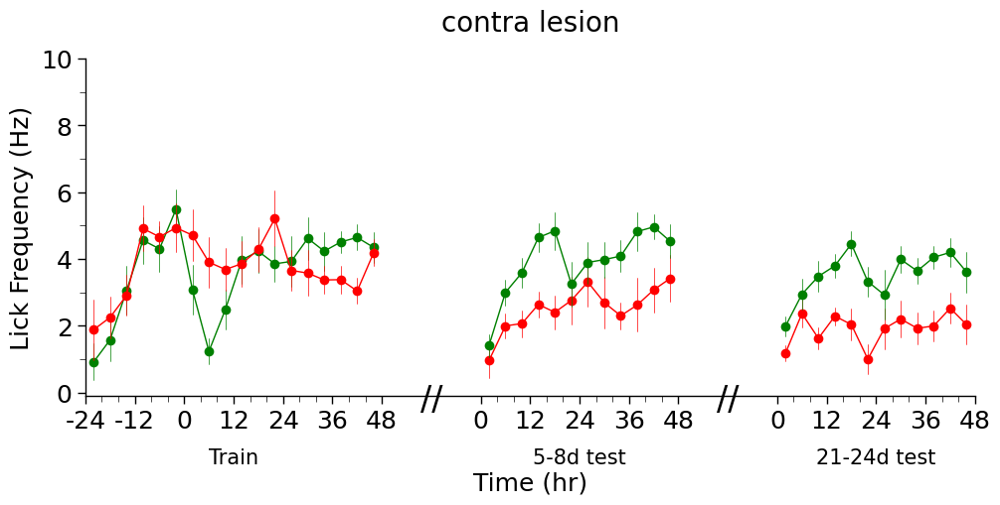

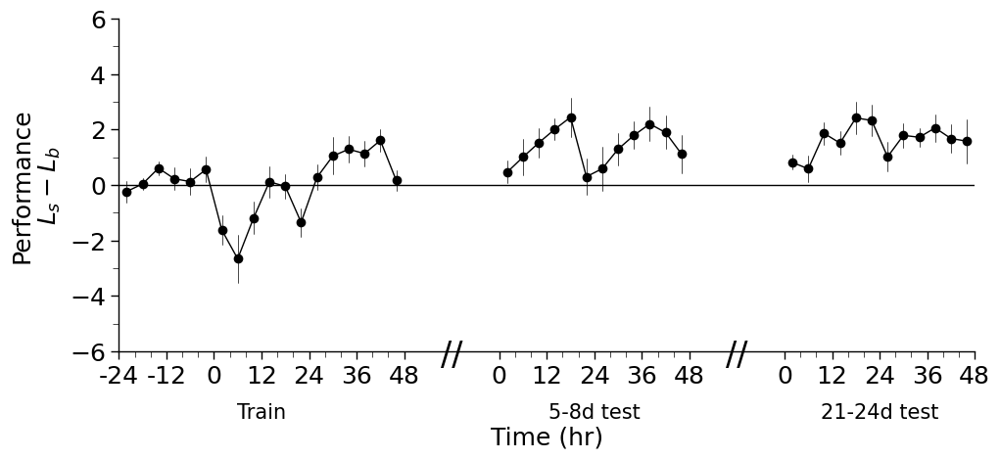

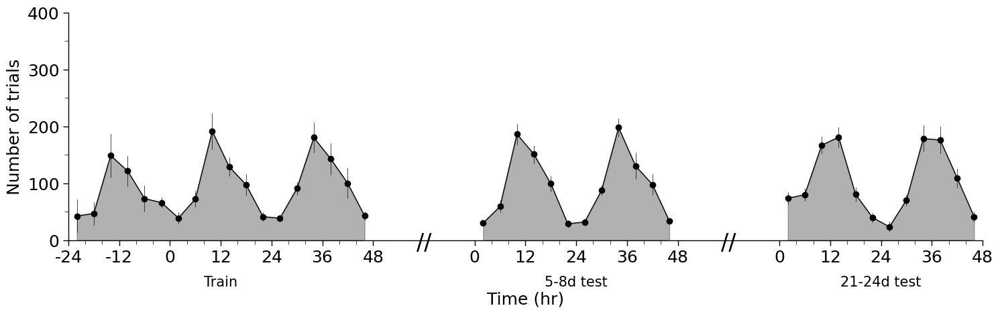

In [41]:
plot_retrain('contra lesion', ant_means_cond, ant_perf_cond, tots_cond,[-24, 192], xticklab)

### Last 20%

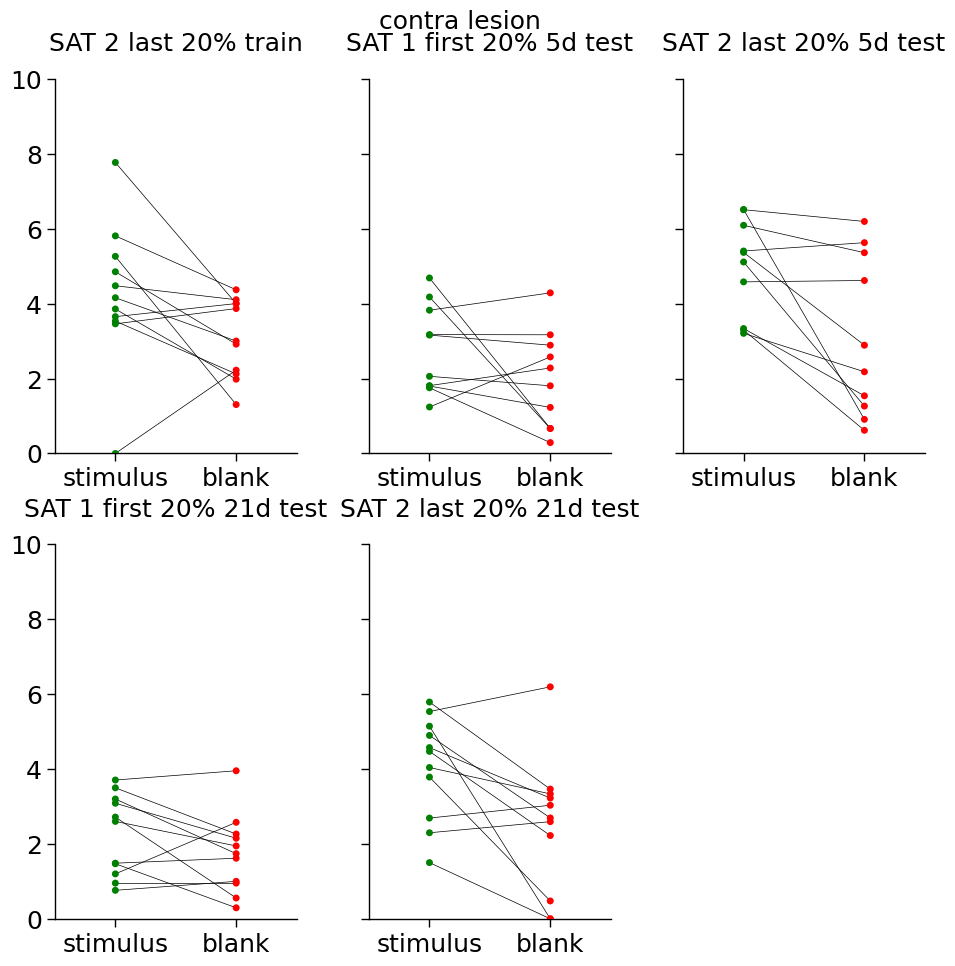

In [26]:
days = ['SAT 2 last 20% train', f'SAT 1 first 20% 5d test', f'SAT 2 last 20% 5d test', f'SAT 1 first 20% 21d test', f'SAT 2 last 20% 21d test']
dayfilt = firstlast20_means[(firstlast20_means.apply(lambda x: x['daytimetest'] in days, axis=1))]
cdfilt = dayfilt[dayfilt["cond"] == 'contra lesion']

g = plot_pair_strip(cdfilt, y="lick",x="stimulus", order=["stimulus", "blank"],
                    hue="stimulus", palette=["green", "red"], col_wrap=3,
                    hue_order=["stimulus", "blank"],col_order=days,
                    col="daytimetest", jitter=False, aspect=0.65, legend=False, connect=True)
g.fig.suptitle('contra lesion', y=1)
#g.tight_layout()
g.fig.subplots_adjust(wspace=0.3)

### Instentanteous lick frequency

#### summary

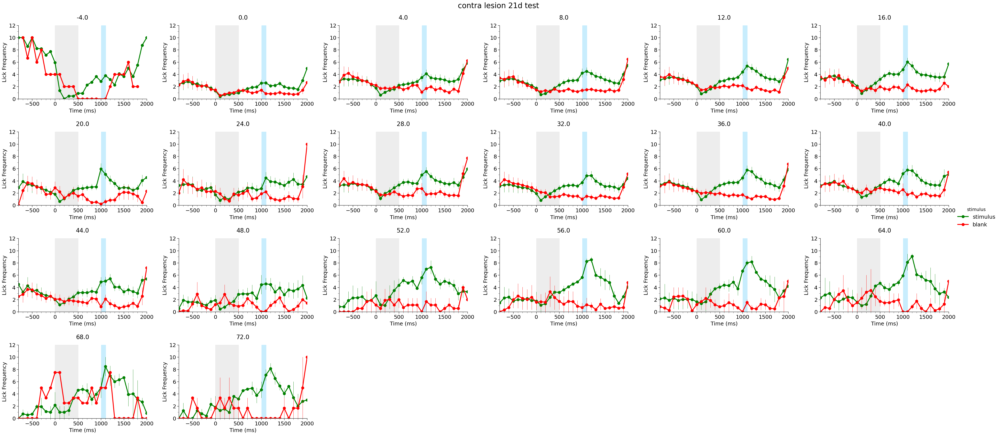

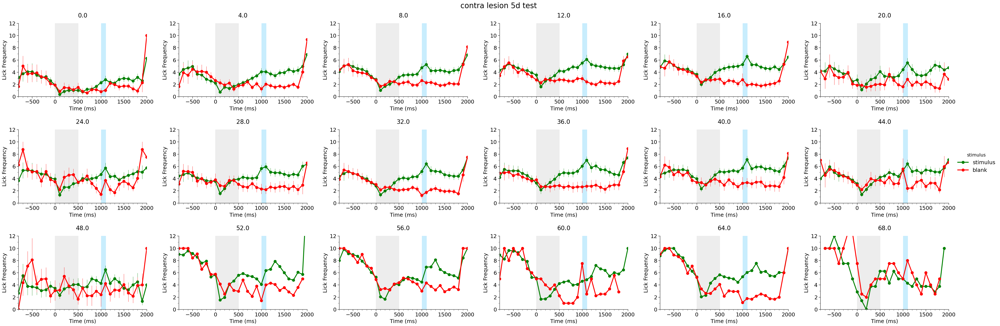

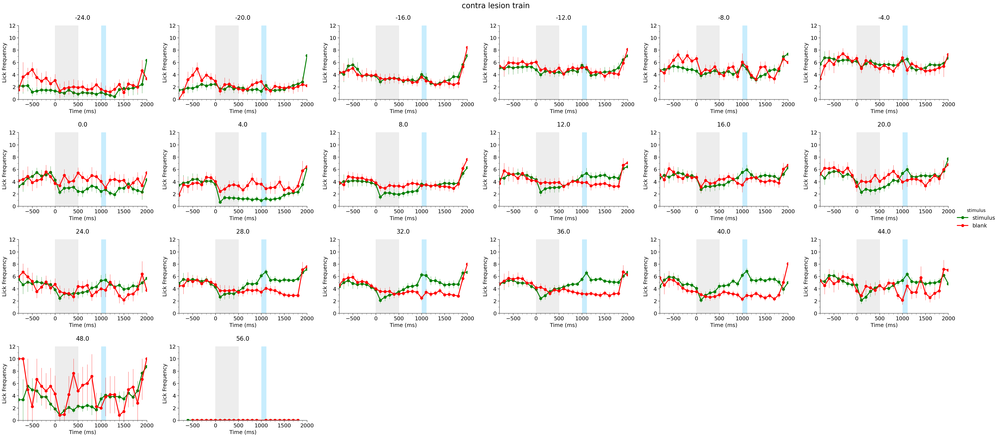

In [27]:
c = 'contra lesion'
for tt in means_full[(means_full['cond'] == c)]['test_time'].unique():    
    plot_lickfreq(means_full[(means_full['cond'] == c) & (means_full['test_time'] == tt)], suptitle=f'{c} {tt}',
                col_wrap=6,errorbar='se', err_style='bars', err_kws={'lw':0.7}, xlim=[-800, 2000])

#### by animal

KeyError: 'Time (hr)'

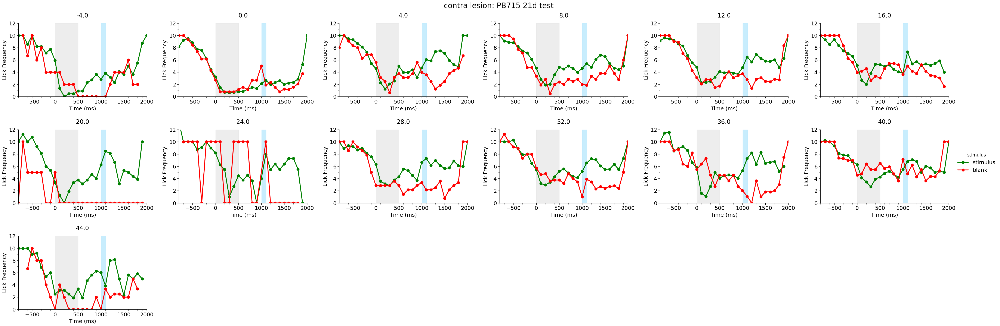

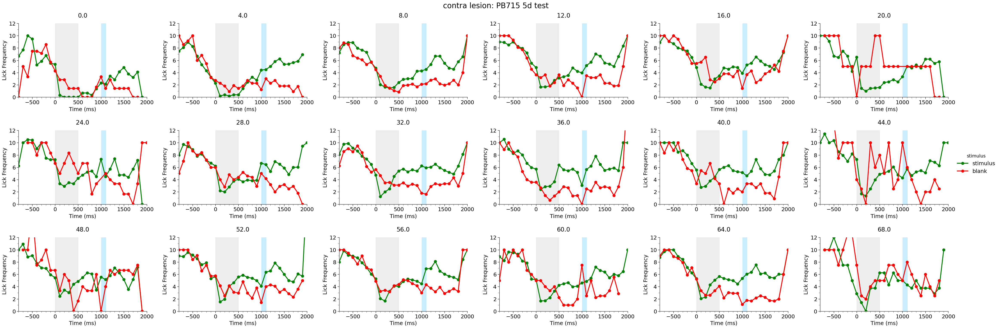

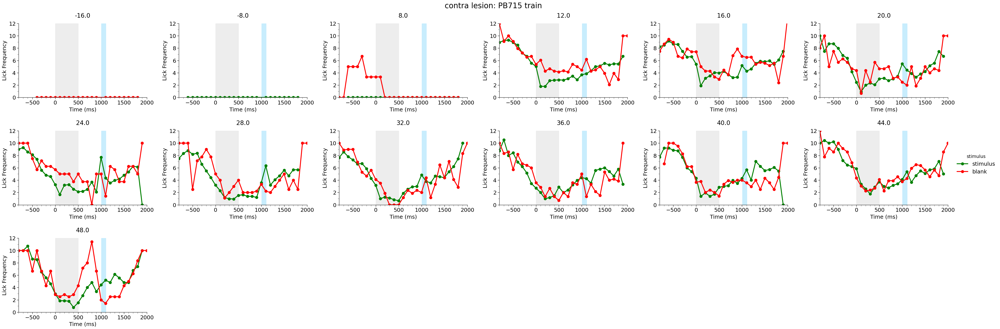

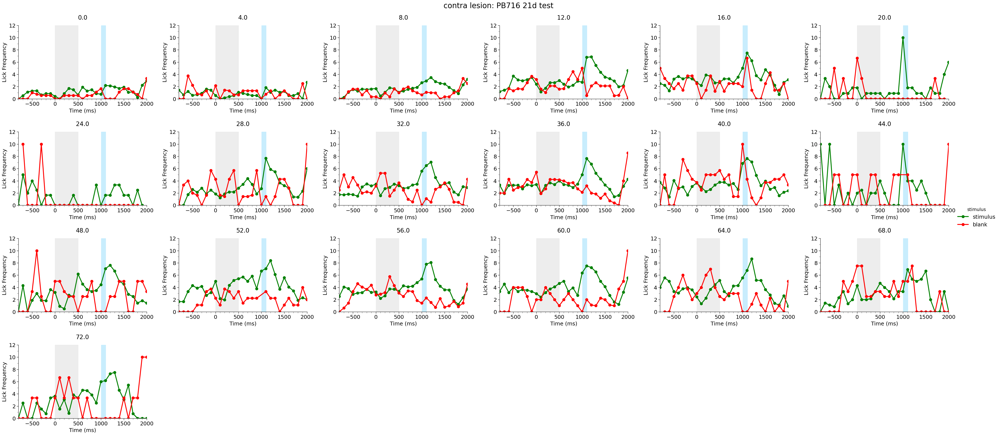

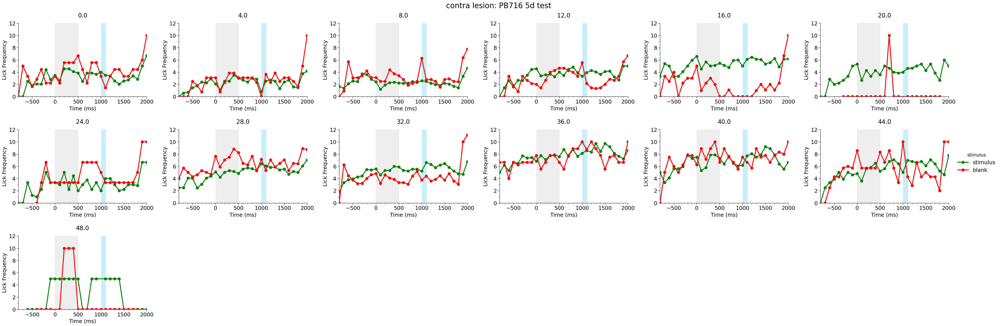

...

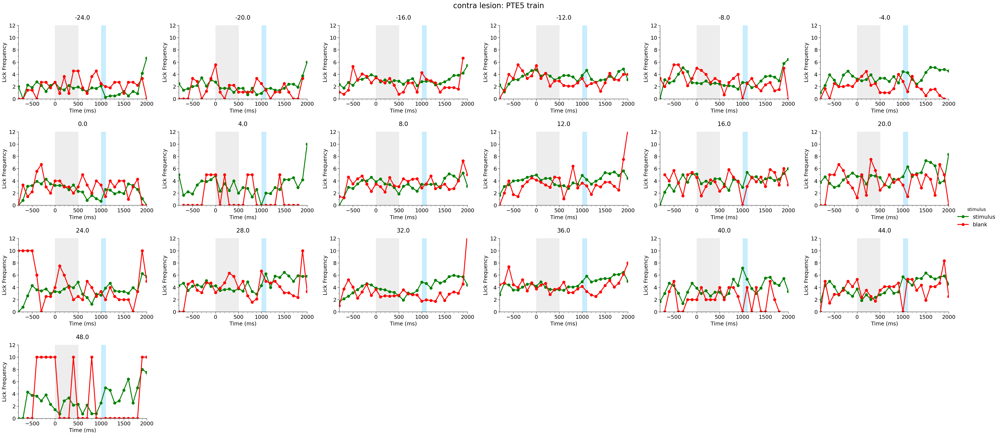

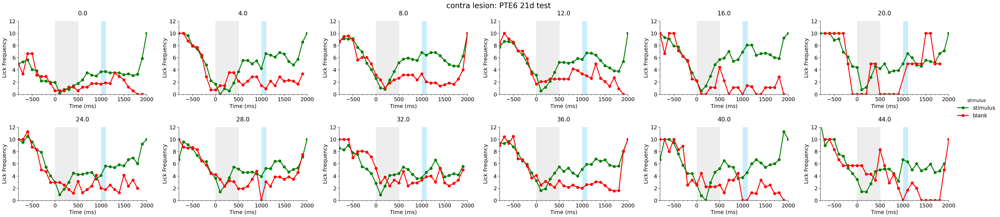

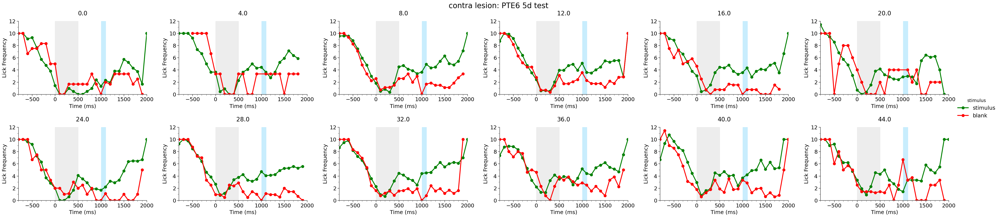

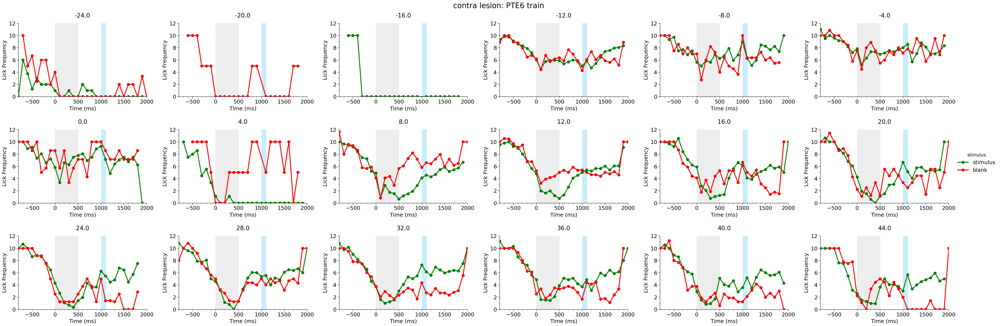

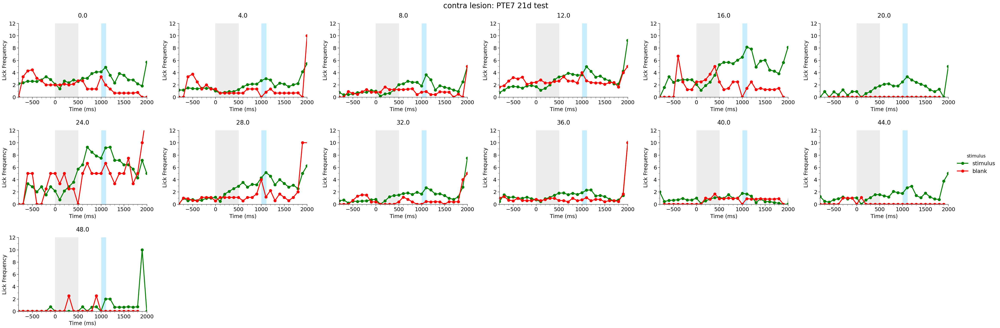

In [28]:
for a in means_full[(means_full['cond'] == c)]['animal'].unique():
    for tt in means_full[(means_full['cond'] == c)]['test_time'].unique():    
        plot_lickfreq(means_full[(means_full['animal'] == a) & (means_full['test_time'] == tt)], suptitle=f'{c}: {a} {tt}',
                    col_wrap=6,errorbar='se', err_style='bars', err_kws={'lw':0.7}, xlim=[-800, 2000])

### Anticipatory lick frequency by animal

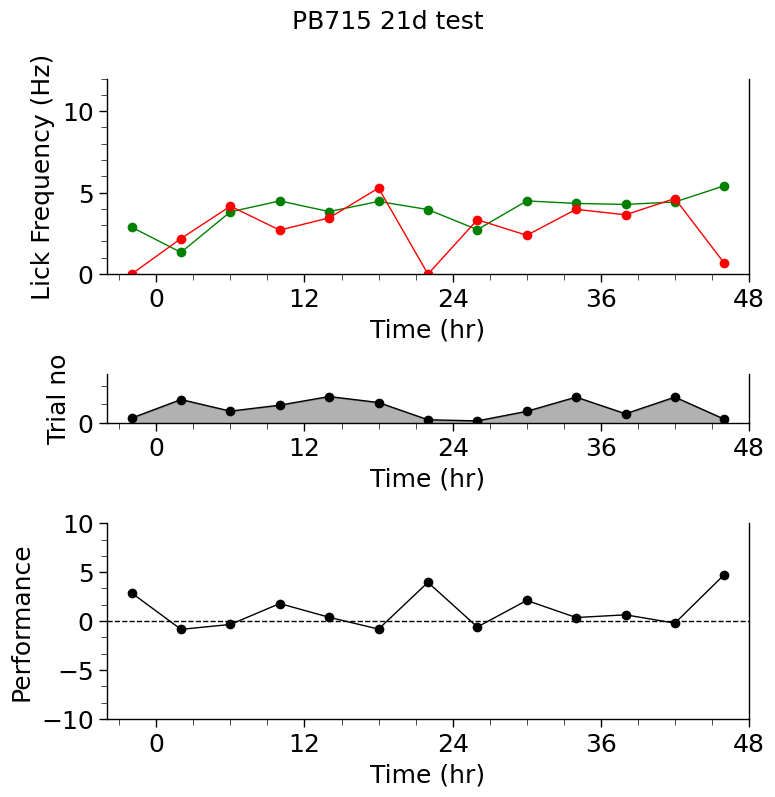

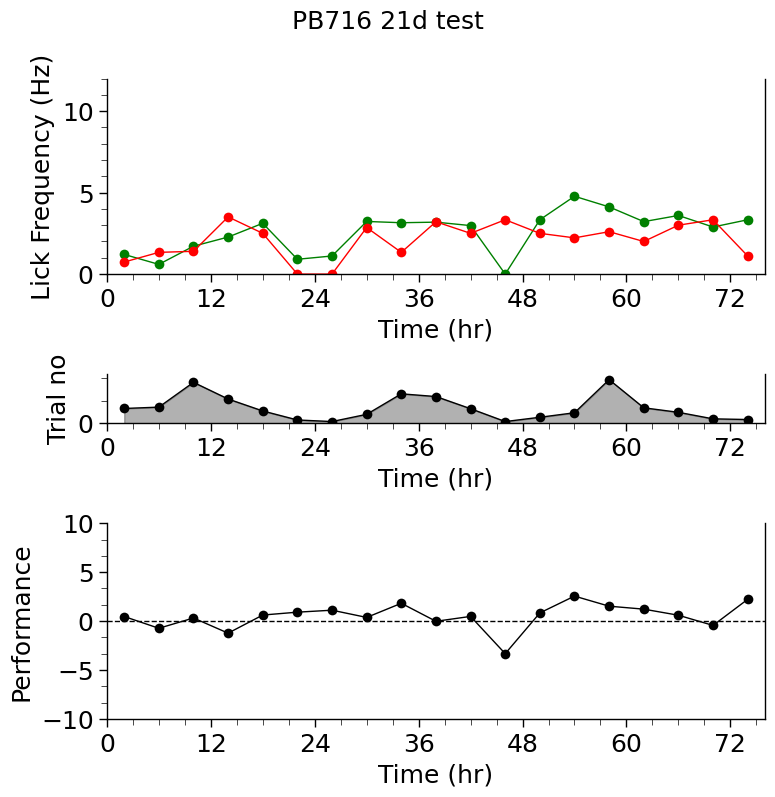

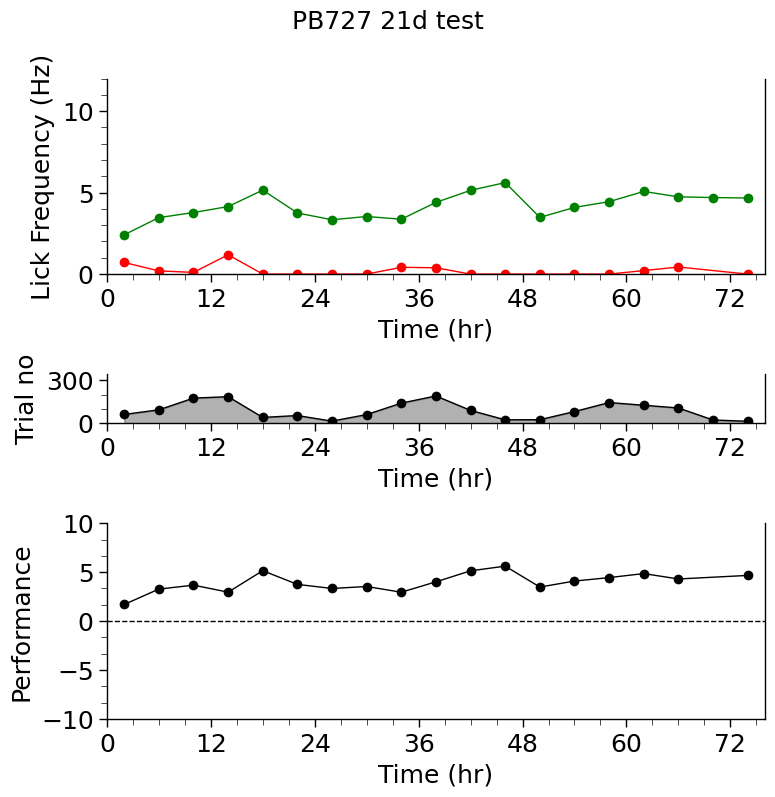

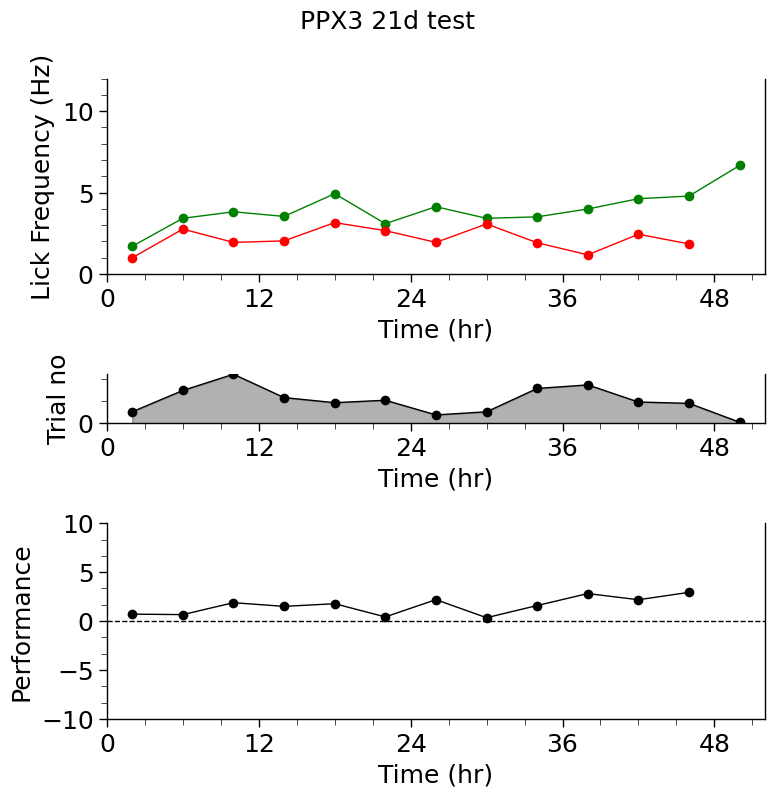

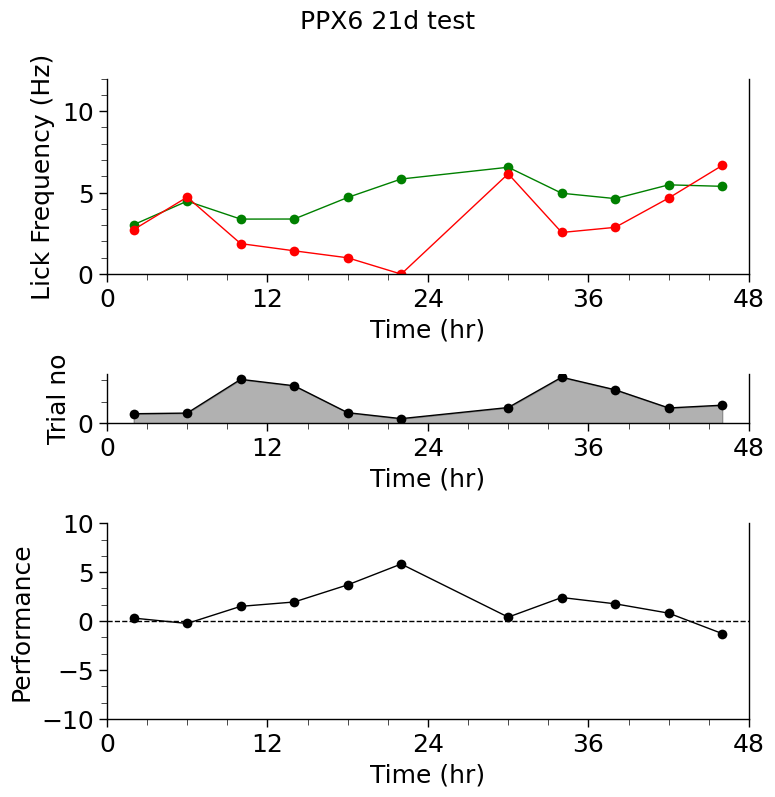

...

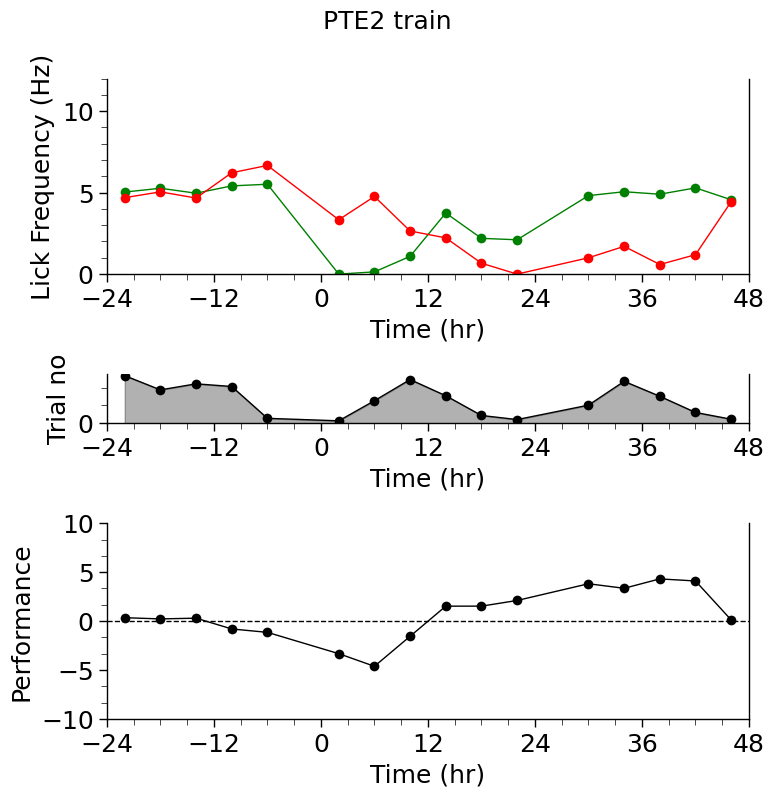

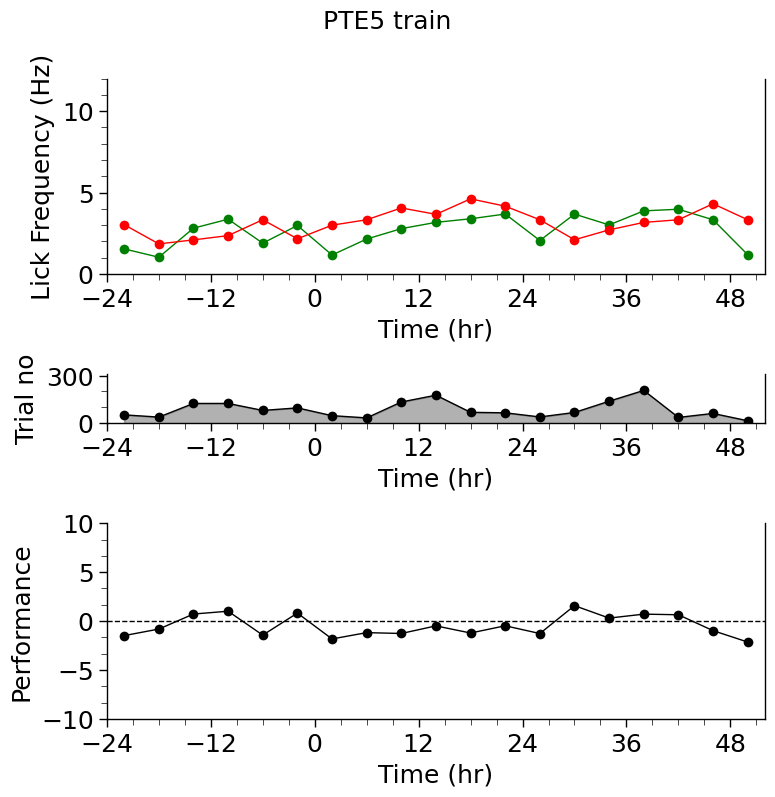

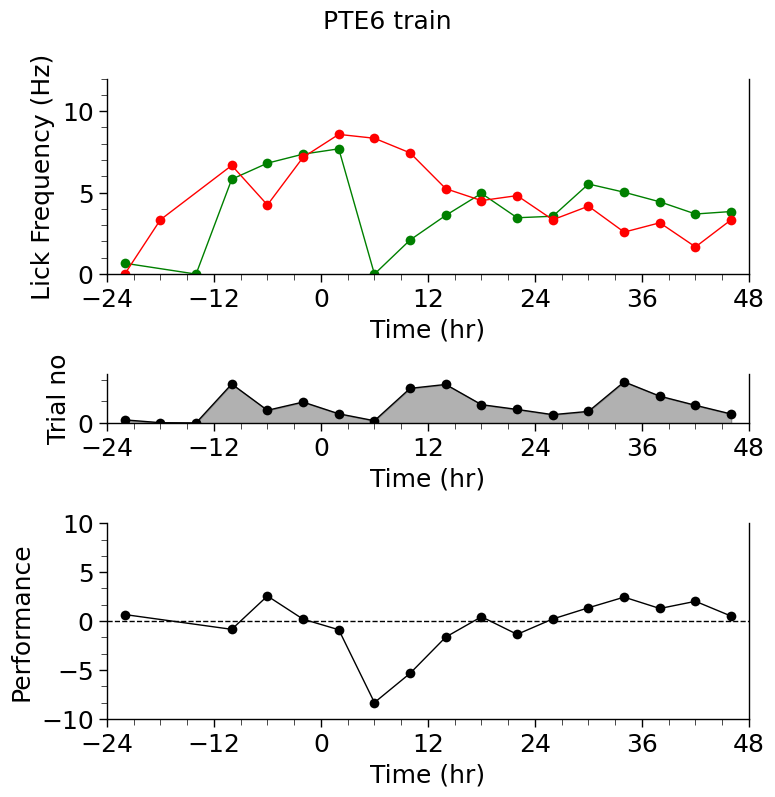

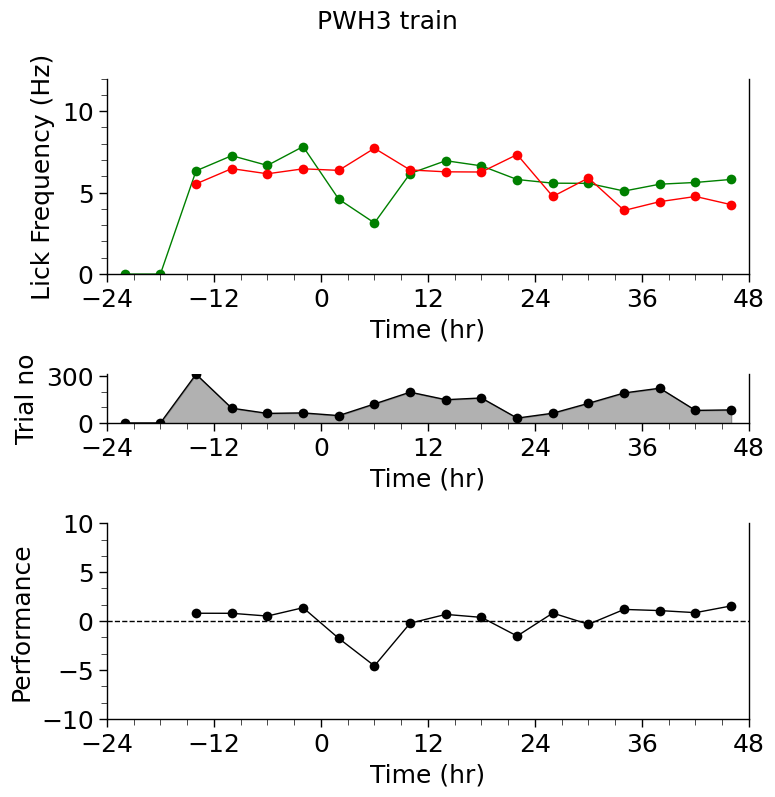

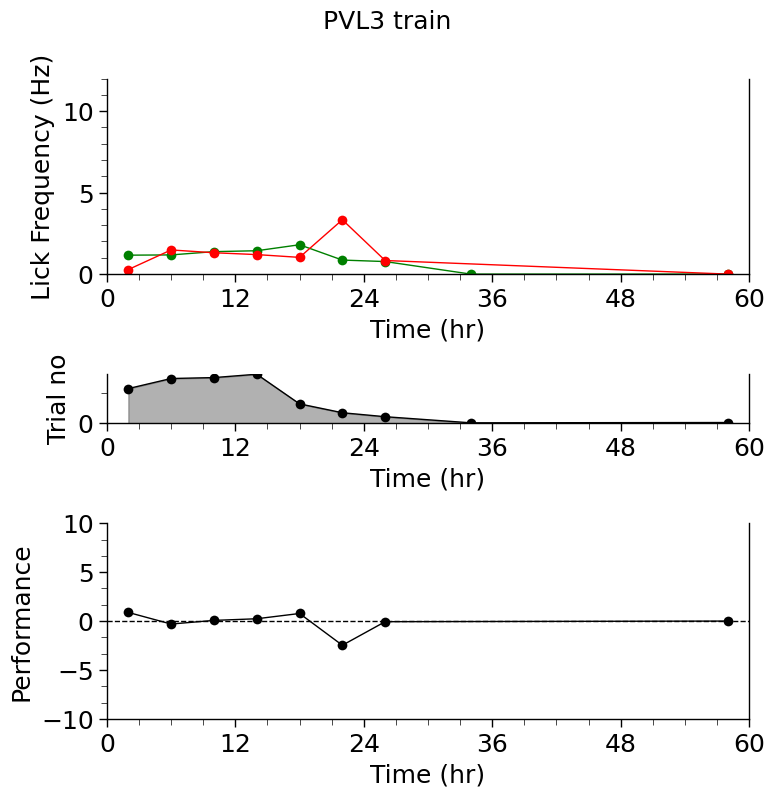

In [29]:
xlim=[-24, 48]
ctmp = ant_means[ant_means['cond'] == 'contra lesion']
for tt in ctmp['test_time'].unique():
    tmp = ctmp[ctmp['test_time'] == tt]
    for a in tmp["animal"].unique():
        xlim = [tmp[(tmp["animal"] == a)]["Time (hr)"].min() - 2, tmp[(tmp["animal"] == a)]["Time (hr)"].max() + 2]
        fg, axs = plt.subplots(3,1, height_ratios=[4,1,4], figsize=(8, 8))
        g = sns.lineplot(tmp[(tmp["animal"] == a)],x='Time (hr)',y='lick',linewidth=1, marker='o', mew=0,markersize=7, ax=axs[0],
                legend=False, errorbar='se', err_style='bars', err_kws={"lw":0.5}, hue='stimulus', hue_order=['stimulus', 'blank'],palette=['green', 'red'])
        g = sns.lineplot(ant_perf[(ant_perf["animal"] == a) & (ant_perf['test_time'] == tt)], y='lick',x='Time (hr)',lw=1,marker='o', mew=0, ms=7,ax=axs[2],
                        legend=False,errorbar='se', err_style='bars', err_kws={"lw":0.5}, color='k')
        g = sns.lineplot(tots[(tots["animal"] == a) & (tots['test_time'] == tt)],x='Time (hr)',y='trial no',ax=axs[1],marker='o', mew=0,
                            ms=7, lw=1,err_kws={"lw":0.5}, color='k')
        
        axs[0].set_ylim([0, 12])
        ymal = ticker.MultipleLocator(5)
        ymil = ticker.MultipleLocator(1)
        axs[0].yaxis.set_major_locator(ymal)
        axs[0].yaxis.set_minor_locator(ymil)
        axs[0].set_ylim([0, 12])
        axs[2].set_ylim([-10, 10])
        ymal = ticker.MultipleLocator(5)
        ymil = ticker.MultipleLocator(5/3)
        axs[2].yaxis.set_major_locator(ymal)
        axs[2].yaxis.set_minor_locator(ymil)
        
        ytrialmax = tots[tots['animal'] == a]['trial no'].max()
        axs[1].set_ylim([0, ytrialmax])
        ymal = ticker.MultipleLocator(300)
        ymil = ticker.MultipleLocator(100)
        axs[1].yaxis.set_major_locator(ymal)
        axs[1].yaxis.set_minor_locator(ymil)

        fg.suptitle(a + ' ' + tt, y=1)
        for ax in axs:
            xmajlocator = ticker.MultipleLocator(12)
            xminlocator = ticker.MultipleLocator(3)
            style_axes_helper(ax, '', 'Time (hr)', '', xlim, ax.get_ylim(), xmajlocator, xminlocator, None,None)

        axs[0].set_ylabel('Lick Frequency (Hz)')
        axs[2].set_ylabel('Performance')
        axs[1].set_ylabel("Trial no")
        axs[1].fill_between(axs[1].lines[0].get_data()[0], axs[1].lines[0].get_data()[1], 
                    color='k', alpha=0.3)
        axs[2].axhline(y=0, xmin=0, xmax=1, ls="--", color="black", zorder=10, lw=1)
        fg.tight_layout()

## Ipsi lesion

### Anticipatory lick frequency summary

(<seaborn.axisgrid.FacetGrid at 0x26f98f2ca90>,
 <seaborn.axisgrid.FacetGrid at 0x26f9d491450>)

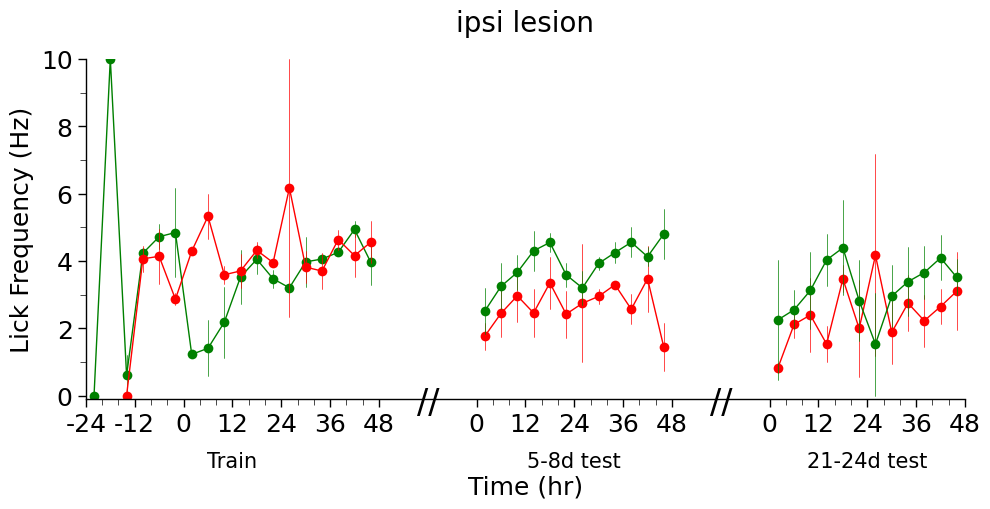

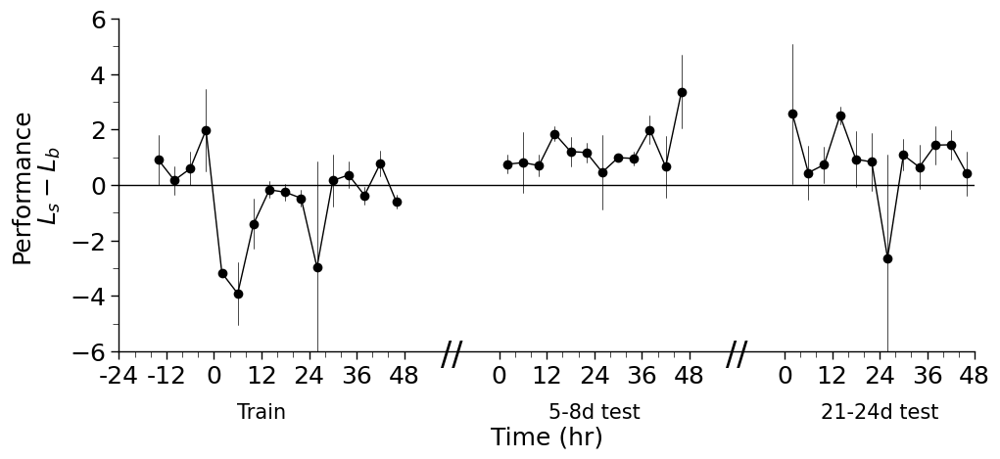

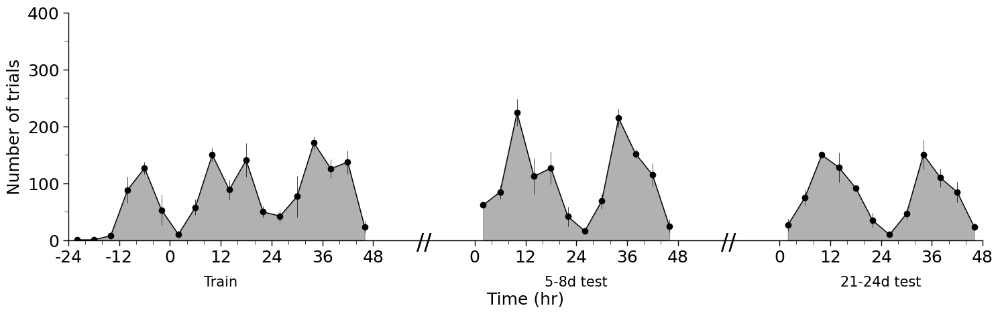

In [39]:
plot_retrain('ipsi lesion', ant_means_cond, ant_perf_cond, tots_cond,[-24, 192], xticklab)

### Last 20%

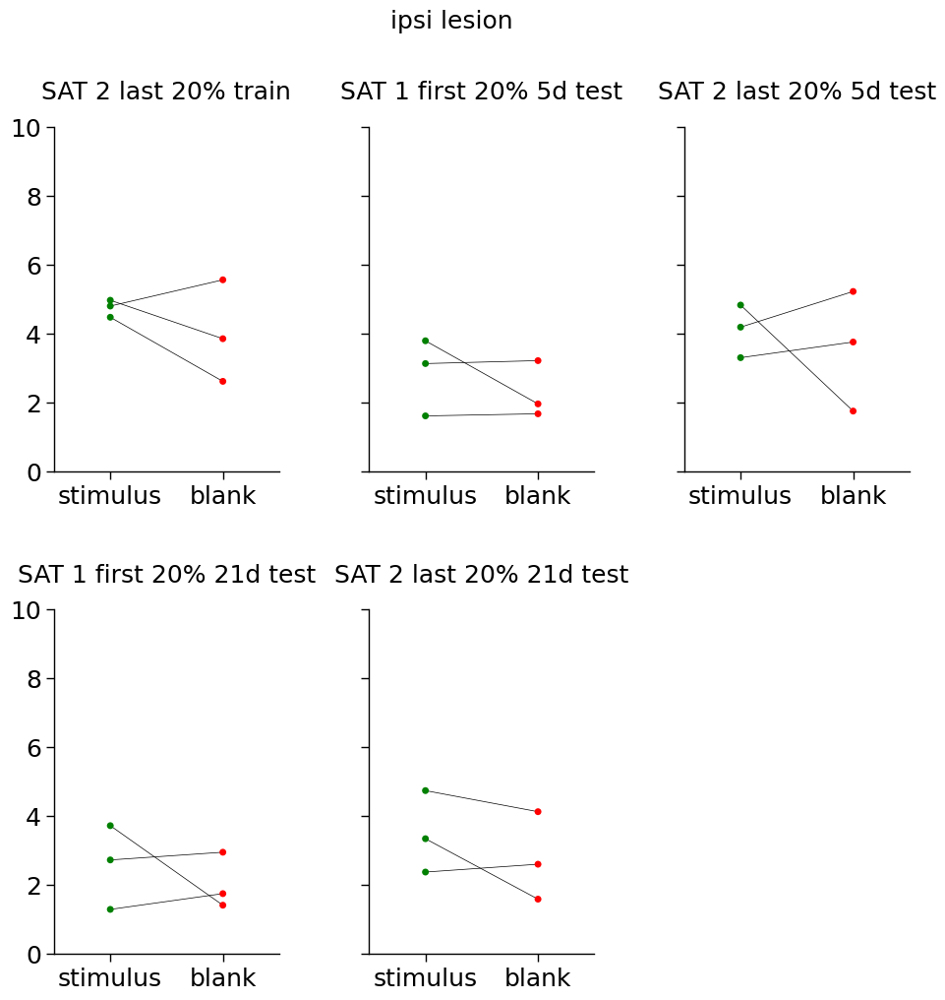

In [31]:
days = ['SAT 2 last 20% train', f'SAT 1 first 20% 5d test', f'SAT 2 last 20% 5d test', f'SAT 1 first 20% 21d test', f'SAT 2 last 20% 21d test']
dayfilt = firstlast20_means[(firstlast20_means.apply(lambda x: x['daytimetest'] in days, axis=1))]
cdfilt = dayfilt[dayfilt["cond"] == 'ipsi lesion']

g = plot_pair_strip(cdfilt, y="lick",x="stimulus", order=["stimulus", "blank"],
                    hue="stimulus", palette=["green", "red"], col_wrap=3,
                    hue_order=["stimulus", "blank"],col_order=days,
                    col="daytimetest", jitter=False, aspect=0.65, legend=False, connect=True)
g.fig.suptitle('ipsi lesion', y=1.05)
#g.tight_layout()
g.fig.subplots_adjust(wspace=0.4, hspace=0.4)

### Instentanteous lick frequency

#### summary

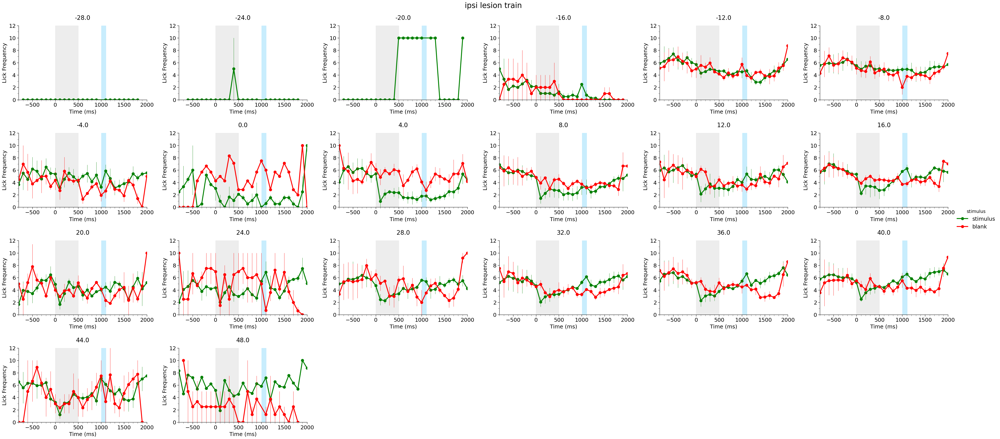

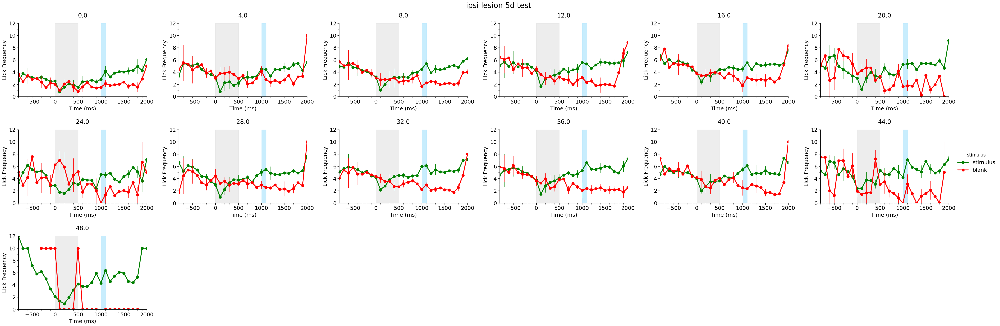

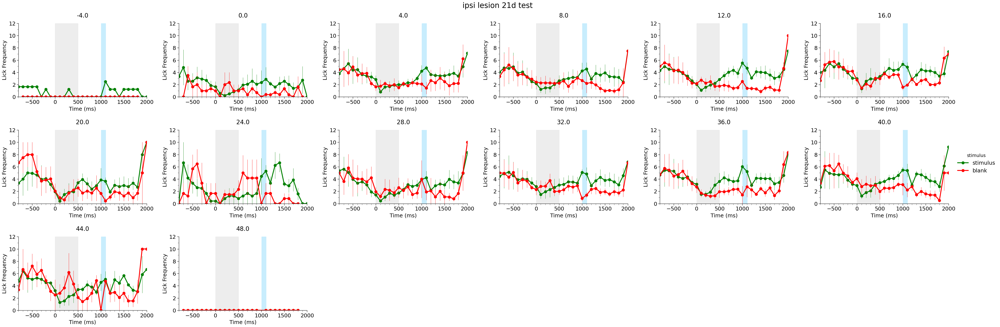

In [32]:
c = 'ipsi lesion'
for tt in means_full[(means_full['cond'] == c)]['test_time'].unique():    
    plot_lickfreq(means_full[(means_full['cond'] == c) & (means_full['test_time'] == tt)], suptitle=f'{c} {tt}',
                col_wrap=6,errorbar='se', err_style='bars', err_kws={'lw':0.7}, xlim=[-800, 2000])

#### by animal

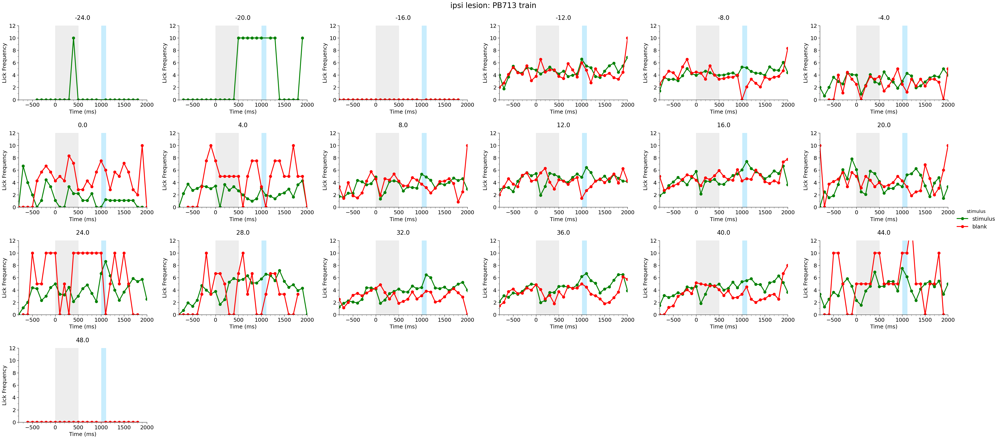

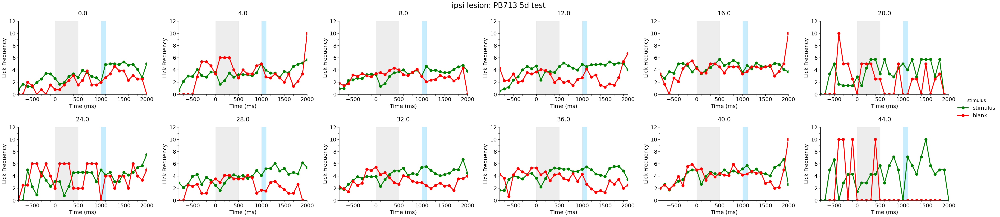

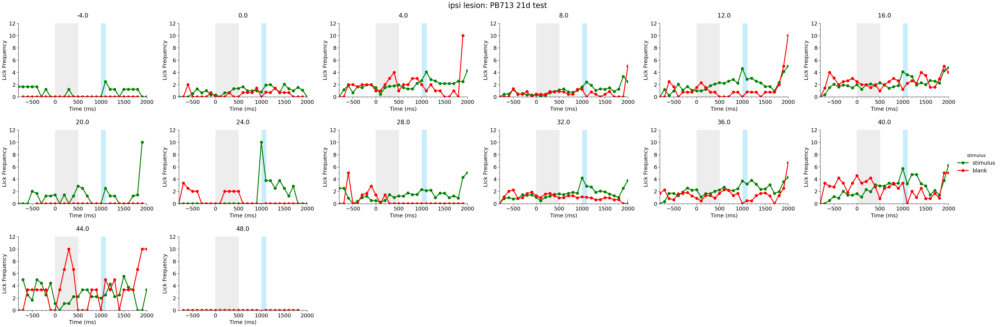

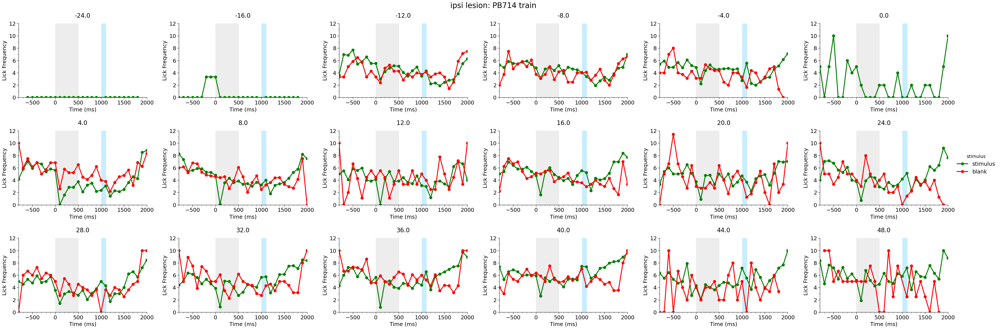

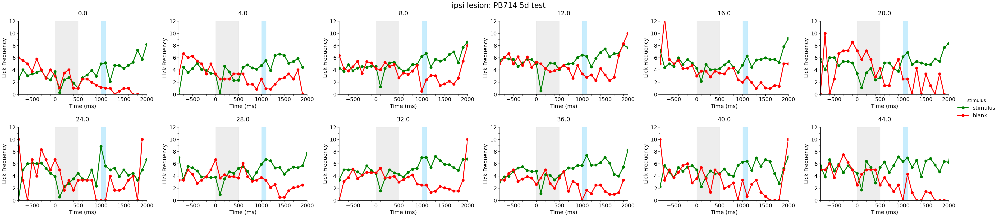

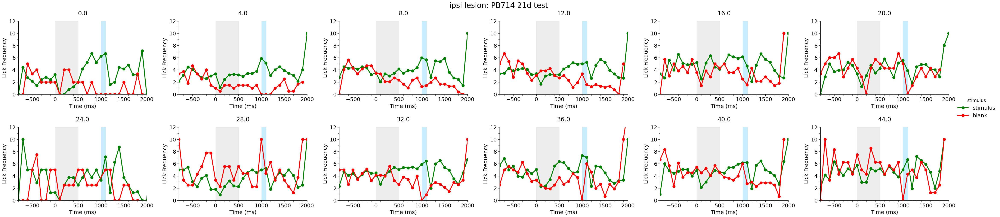

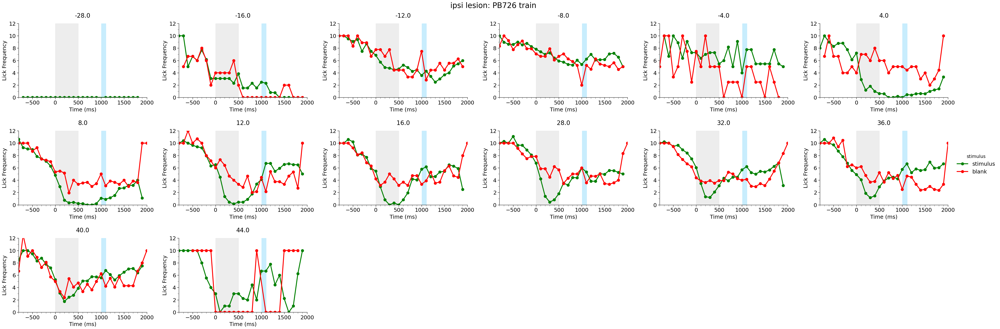

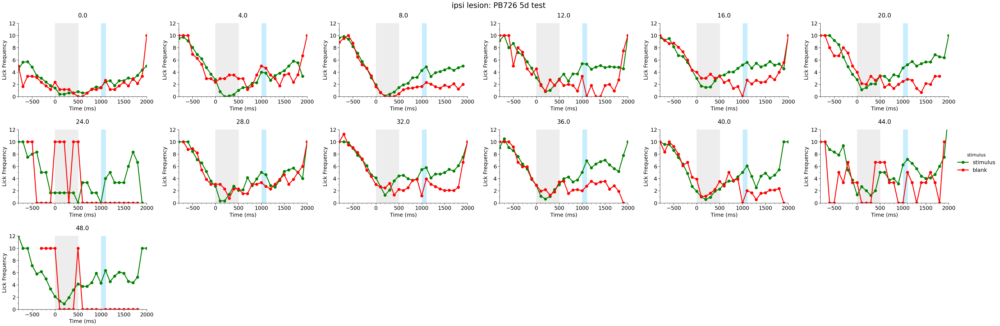

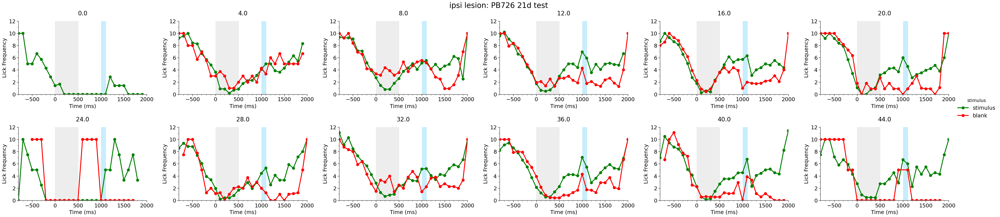

In [33]:
for a in means_full[(means_full['cond'] == c)]['animal'].unique():
    for tt in means_full[(means_full['cond'] == c)]['test_time'].unique():    
        plot_lickfreq(means_full[(means_full['animal'] == a) & (means_full['test_time'] == tt)], suptitle=f'{c}: {a} {tt}',
                    col_wrap=6,errorbar='se', err_style='bars', err_kws={'lw':0.7}, xlim=[-800, 2000])

### Anticipatory lick frequency by animal

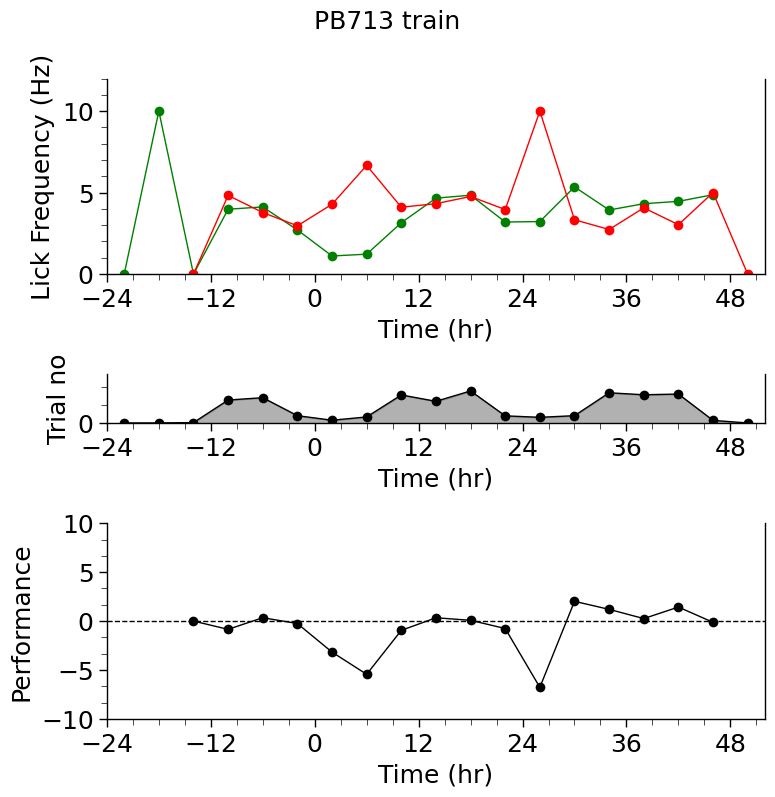

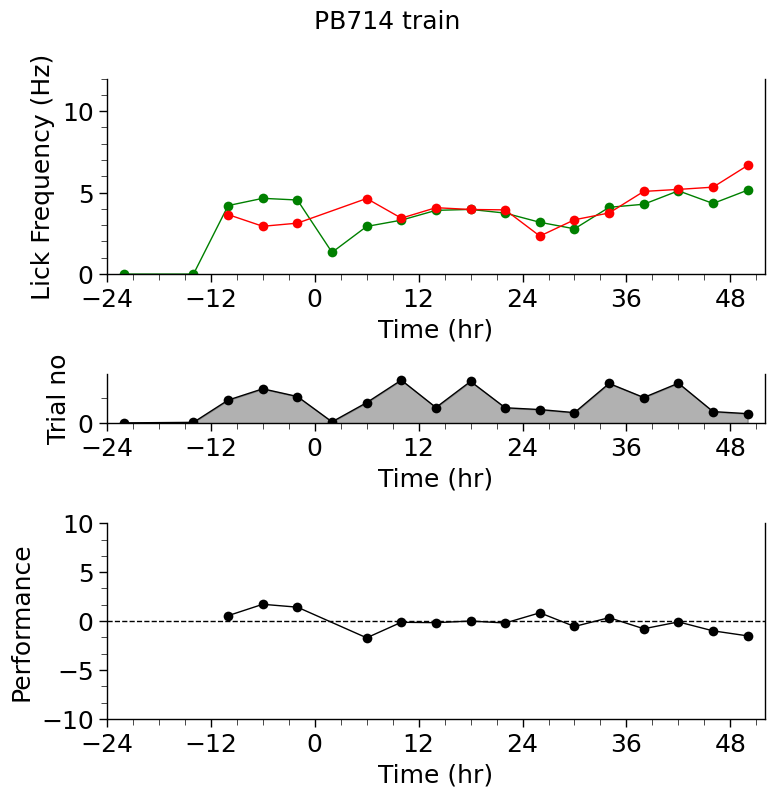

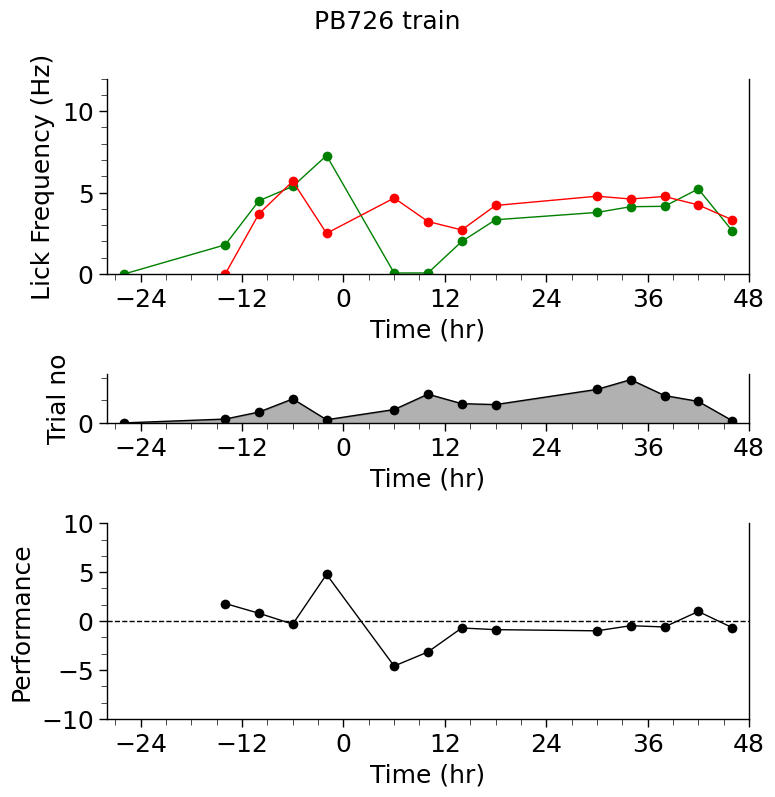

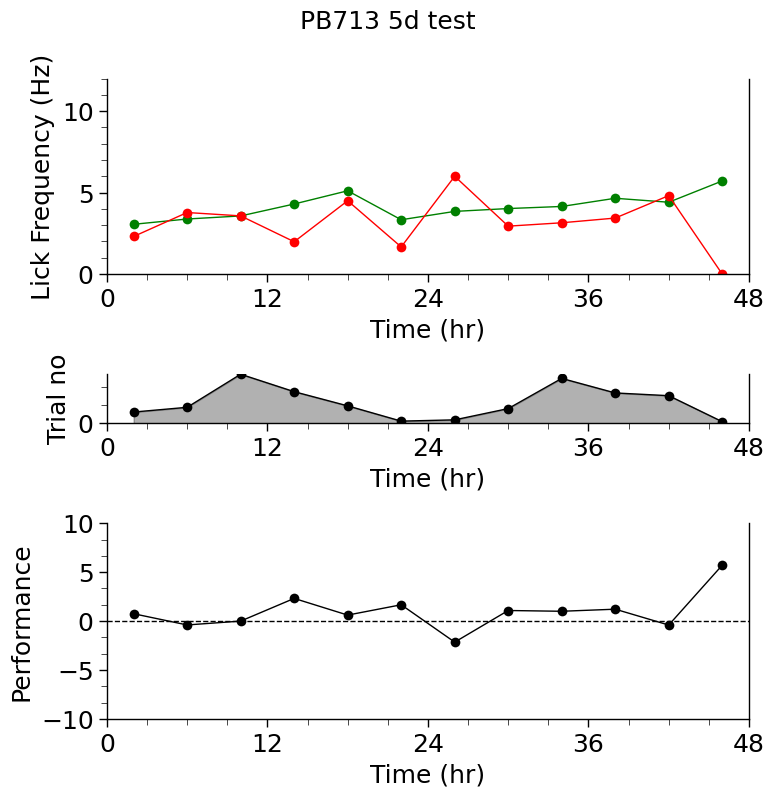

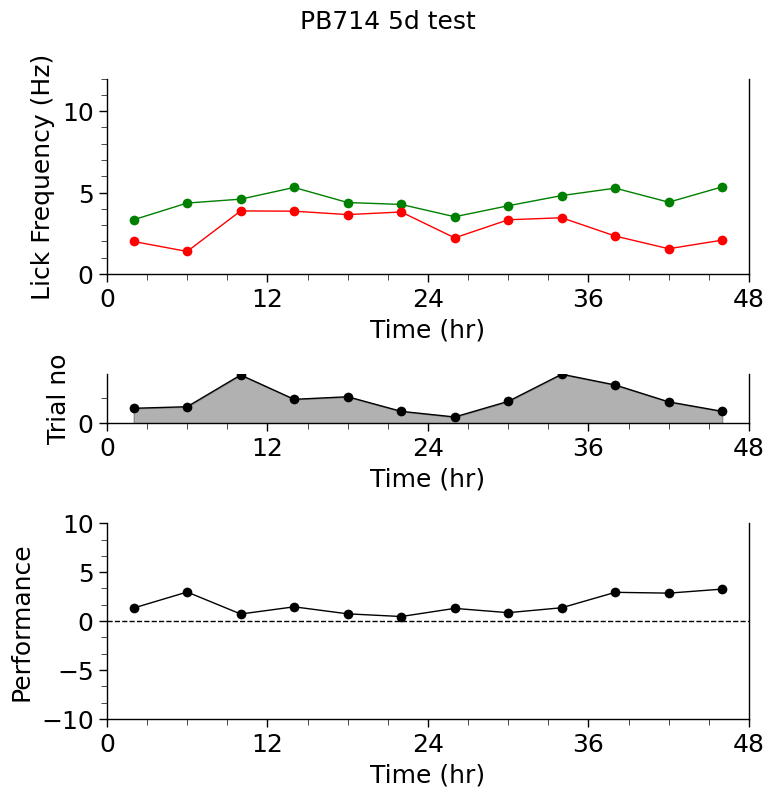

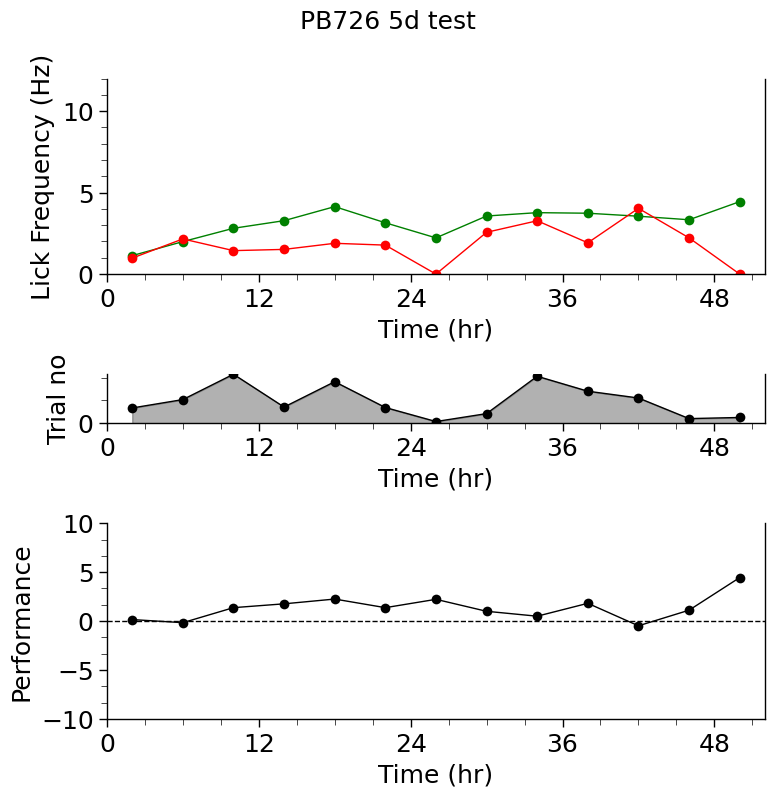

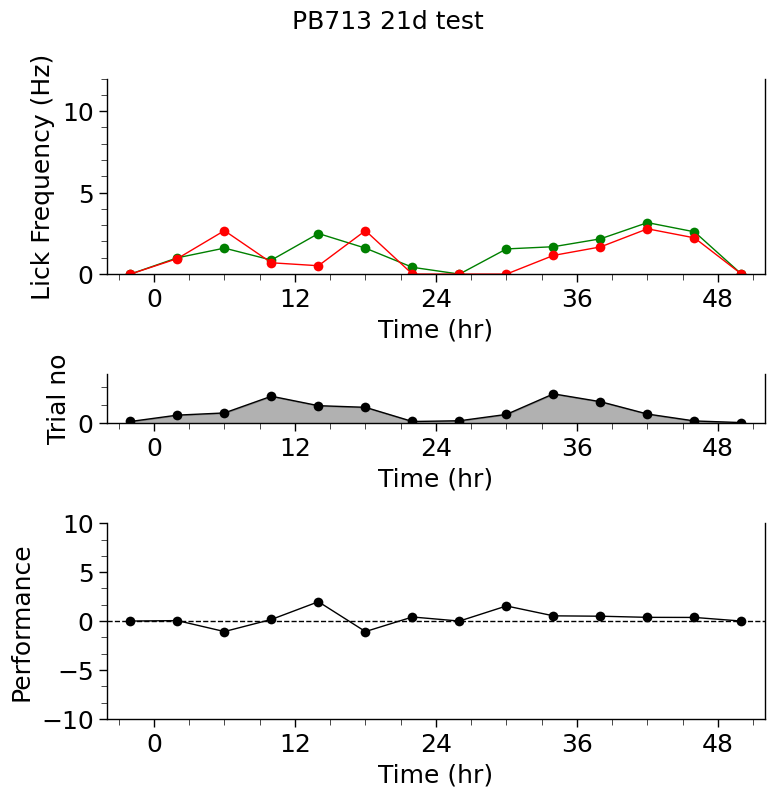

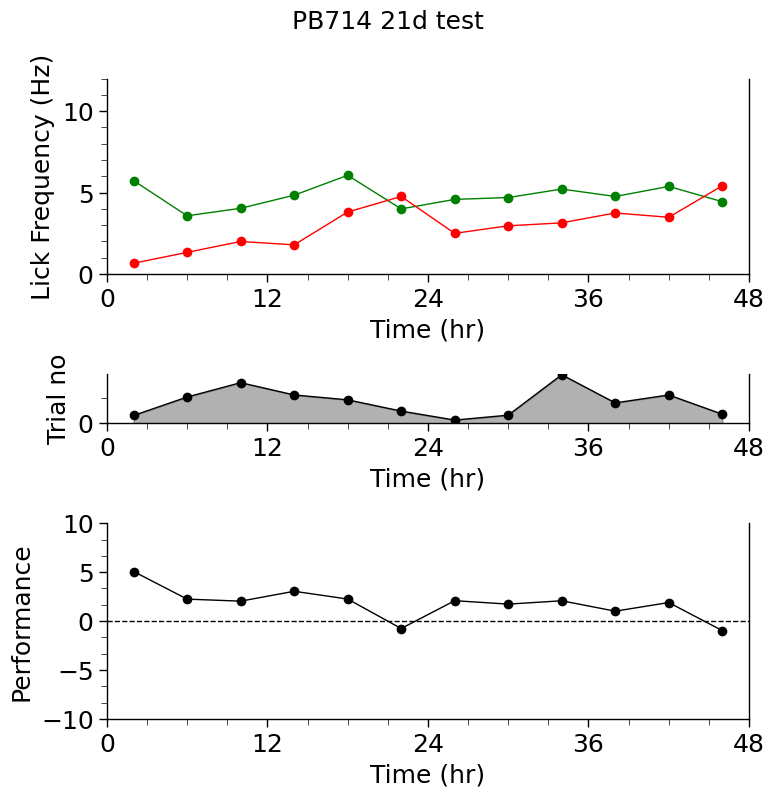

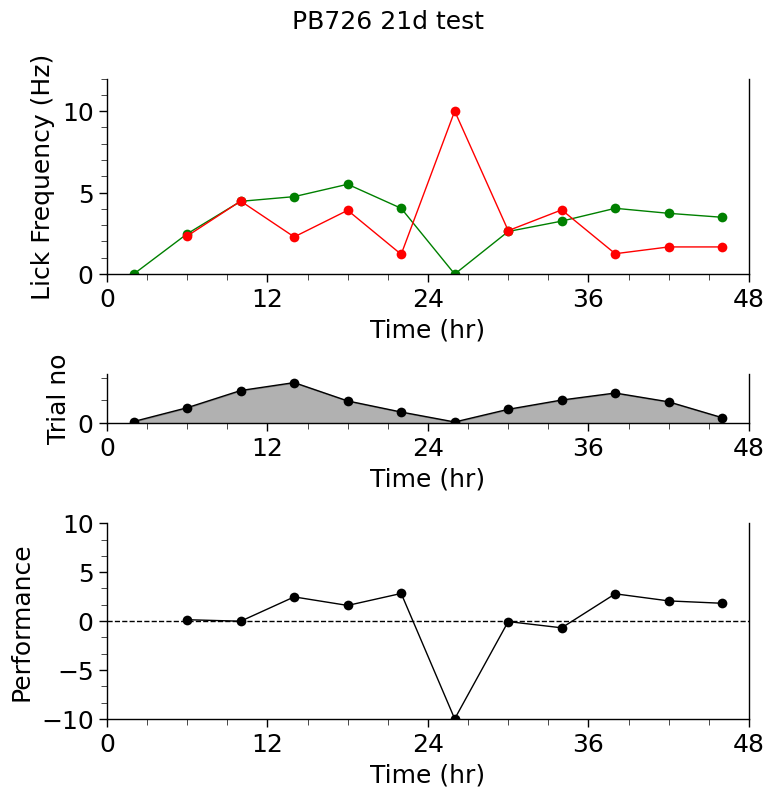

In [34]:
xlim=[-24, 48]
ctmp = ant_means[ant_means['cond'] == 'ipsi lesion']
for tt in ctmp['test_time'].unique():
    tmp = ctmp[ctmp['test_time'] == tt]
    for a in tmp["animal"].unique():
        xlim = [tmp[(tmp["animal"] == a)]["Time (hr)"].min() - 2, tmp[(tmp["animal"] == a)]["Time (hr)"].max() + 2]
        fg, axs = plt.subplots(3,1, height_ratios=[4,1,4], figsize=(8, 8))
        g = sns.lineplot(tmp[(tmp["animal"] == a)],x='Time (hr)',y='lick',linewidth=1, marker='o', mew=0,markersize=7, ax=axs[0],
                legend=False, errorbar='se', err_style='bars', err_kws={"lw":0.5}, hue='stimulus', hue_order=['stimulus', 'blank'],palette=['green', 'red'])
        g = sns.lineplot(ant_perf[(ant_perf["animal"] == a) & (ant_perf['test_time'] == tt)], y='lick',x='Time (hr)',lw=1,marker='o', mew=0, ms=7,ax=axs[2],
                        legend=False,errorbar='se', err_style='bars', err_kws={"lw":0.5}, color='k')
        g = sns.lineplot(tots[(tots["animal"] == a) & (tots['test_time'] == tt)],x='Time (hr)',y='trial no',ax=axs[1],marker='o', mew=0,
                            ms=7, lw=1,err_kws={"lw":0.5}, color='k')
        
        axs[0].set_ylim([0, 12])
        ymal = ticker.MultipleLocator(5)
        ymil = ticker.MultipleLocator(1)
        axs[0].yaxis.set_major_locator(ymal)
        axs[0].yaxis.set_minor_locator(ymil)
        axs[0].set_ylim([0, 12])
        axs[2].set_ylim([-10, 10])
        ymal = ticker.MultipleLocator(5)
        ymil = ticker.MultipleLocator(5/3)
        axs[2].yaxis.set_major_locator(ymal)
        axs[2].yaxis.set_minor_locator(ymil)
        
        ytrialmax = tots[tots['animal'] == a]['trial no'].max()
        axs[1].set_ylim([0, ytrialmax])
        ymal = ticker.MultipleLocator(300)
        ymil = ticker.MultipleLocator(100)
        axs[1].yaxis.set_major_locator(ymal)
        axs[1].yaxis.set_minor_locator(ymil)

        fg.suptitle(a + ' ' + tt, y=1)
        for ax in axs:
            xmajlocator = ticker.MultipleLocator(12)
            xminlocator = ticker.MultipleLocator(3)
            style_axes_helper(ax, '', 'Time (hr)', '', xlim, ax.get_ylim(), xmajlocator, xminlocator, None,None)

        axs[0].set_ylabel('Lick Frequency (Hz)')
        axs[2].set_ylabel('Performance')
        axs[1].set_ylabel("Trial no")
        axs[1].fill_between(axs[1].lines[0].get_data()[0], axs[1].lines[0].get_data()[1], 
                    color='k', alpha=0.3)
        axs[2].axhline(y=0, xmin=0, xmax=1, ls="--", color="black", zorder=10, lw=1)
        fg.tight_layout()

## Sham lesion

### Anticipatory lick frequency summary

(<seaborn.axisgrid.FacetGrid at 0x26f10c5b4d0>,
 <seaborn.axisgrid.FacetGrid at 0x26f08af9b90>)

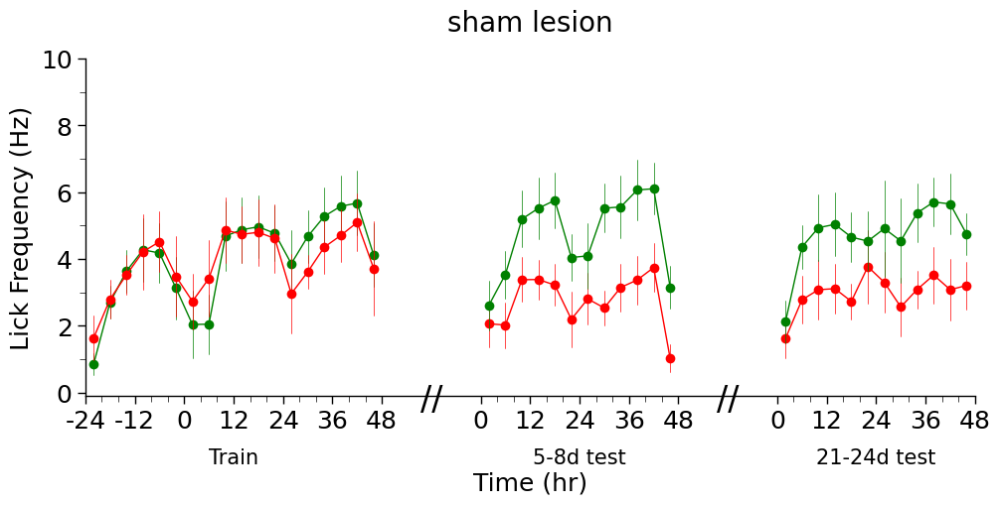

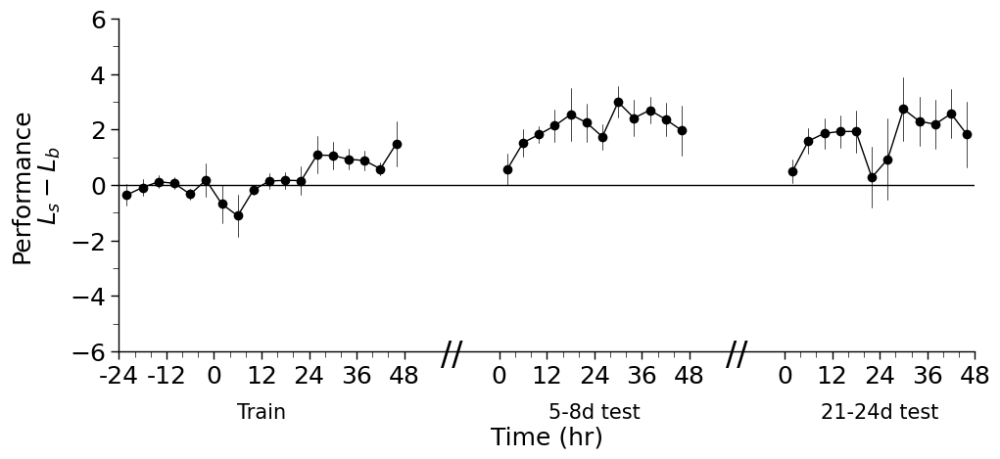

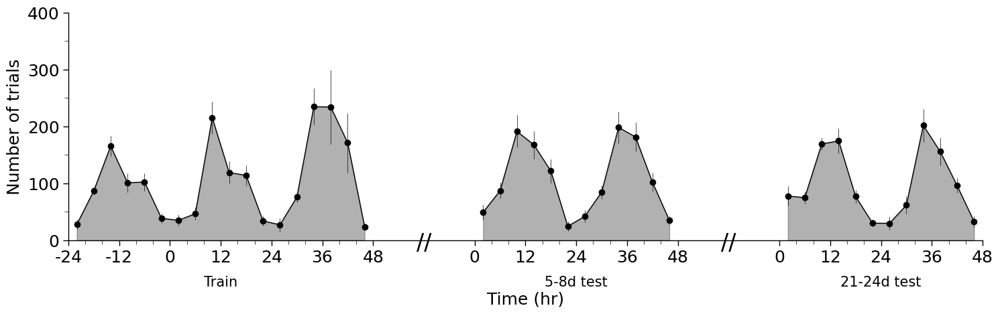

In [42]:
plot_retrain('sham lesion',ant_means_cond, ant_perf_cond, tots_cond, [-24, 192], xticklab)

### Last 20%

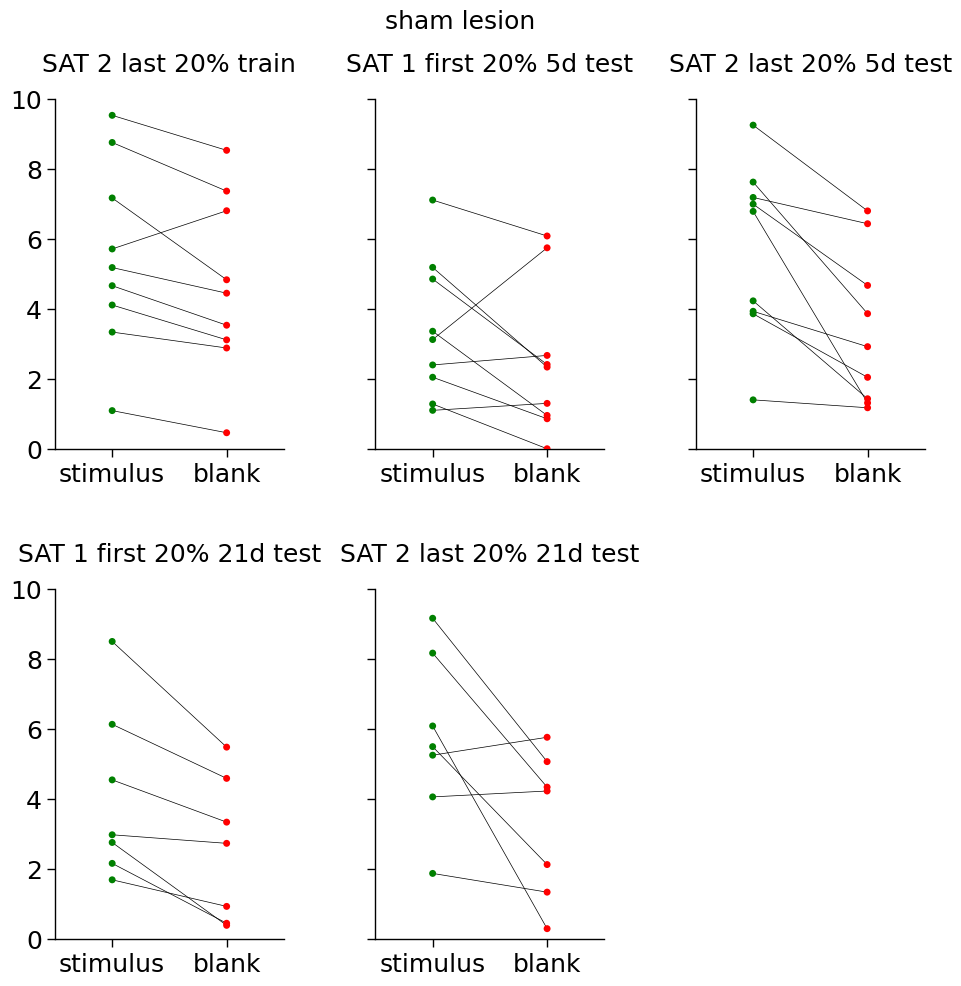

In [36]:
days = ['SAT 2 last 20% train', f'SAT 1 first 20% 5d test', f'SAT 2 last 20% 5d test', f'SAT 1 first 20% 21d test', f'SAT 2 last 20% 21d test']
dayfilt = firstlast20_means[(firstlast20_means.apply(lambda x: x['daytimetest'] in days, axis=1))]
cdfilt = dayfilt[dayfilt["cond"] == 'sham lesion']

g = plot_pair_strip(cdfilt, y="lick",x="stimulus", order=["stimulus", "blank"],
                    hue="stimulus", palette=["green", "red"], col_wrap=3,
                    hue_order=["stimulus", "blank"],col_order=days,
                    col="daytimetest", jitter=False, aspect=0.65, legend=False, connect=True)
g.fig.suptitle('sham lesion', y=1.02)
#g.tight_layout()
g.fig.subplots_adjust(wspace=0.4, hspace=0.4)

### Instentanteous lick frequency

#### summary

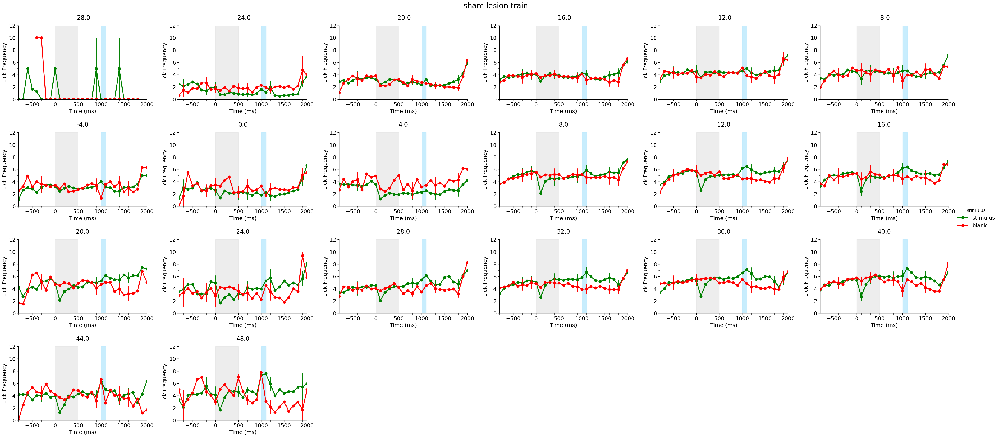

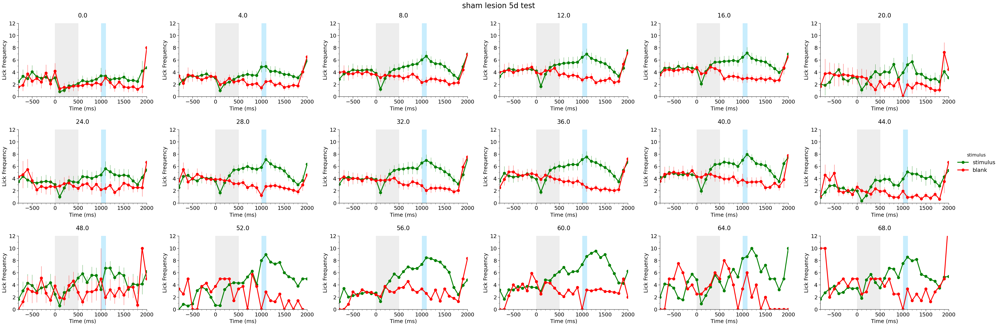

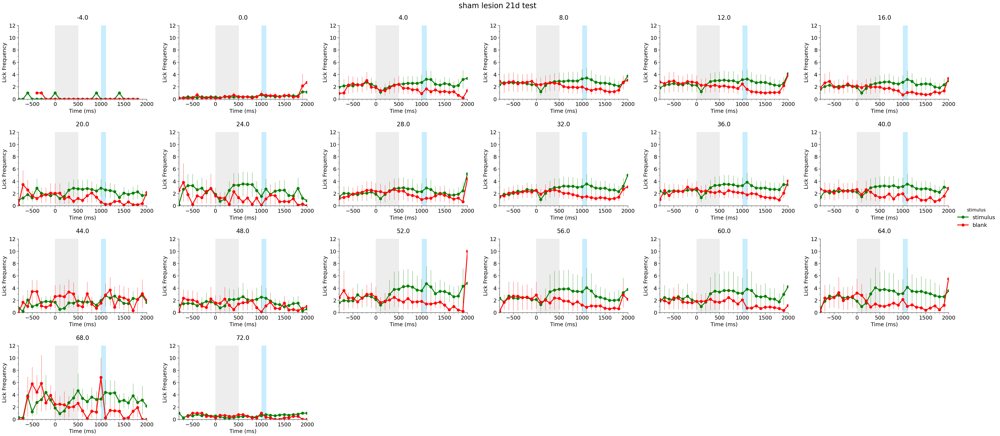

In [37]:
c = 'sham lesion'
for tt in means_full[(means_full['cond'] == c)]['test_time'].unique():    
    plot_lickfreq(means_full[(means_full['cond'] == c) & (means_full['test_time'] == tt)], suptitle=f'{c} {tt}',
                col_wrap=6,errorbar='se', err_style='bars', err_kws={'lw':0.7}, xlim=[-800, 2000])

#### by animal

KeyError: 'Time (hr)'

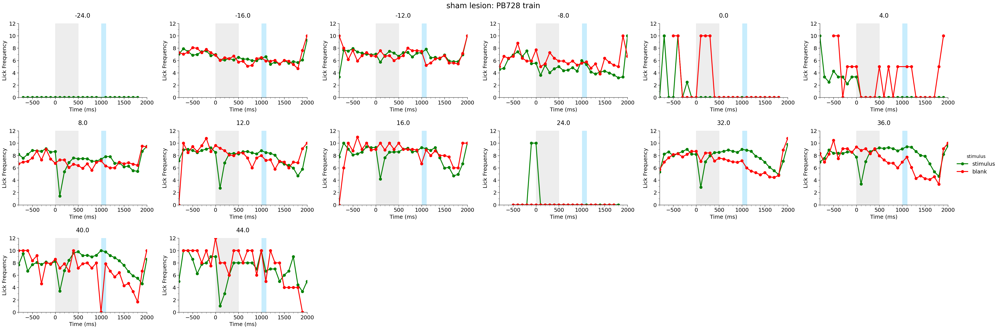

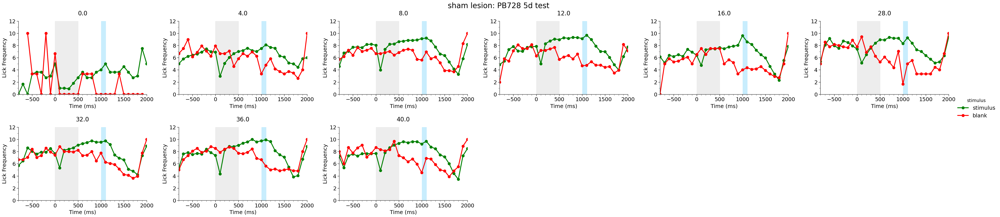

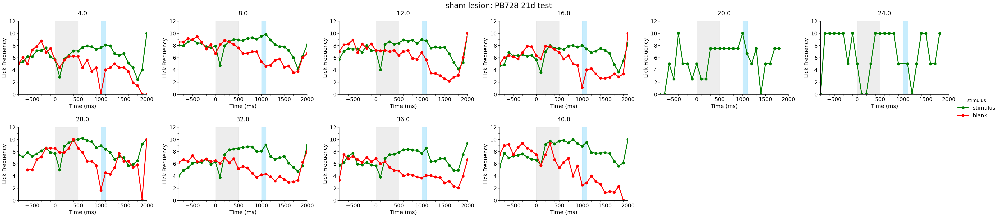

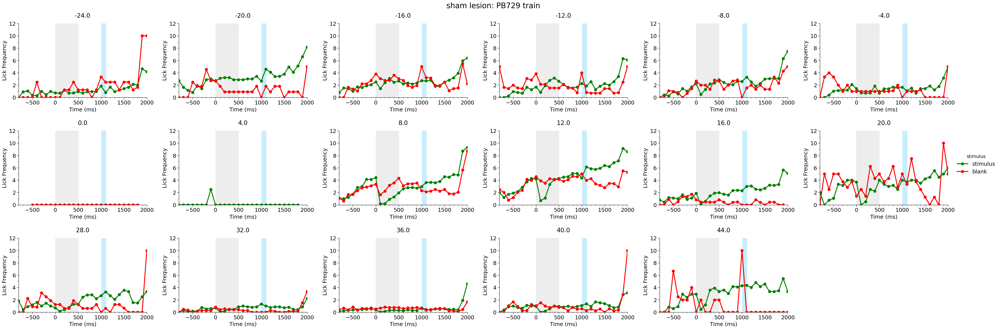

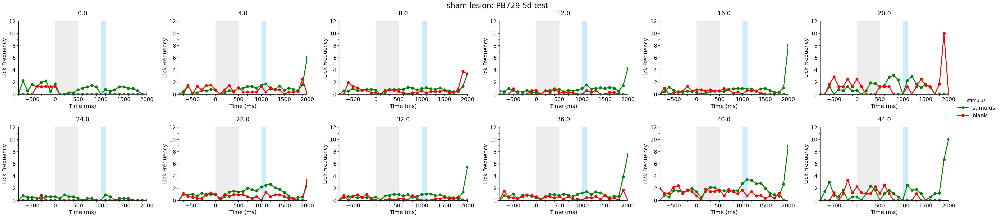

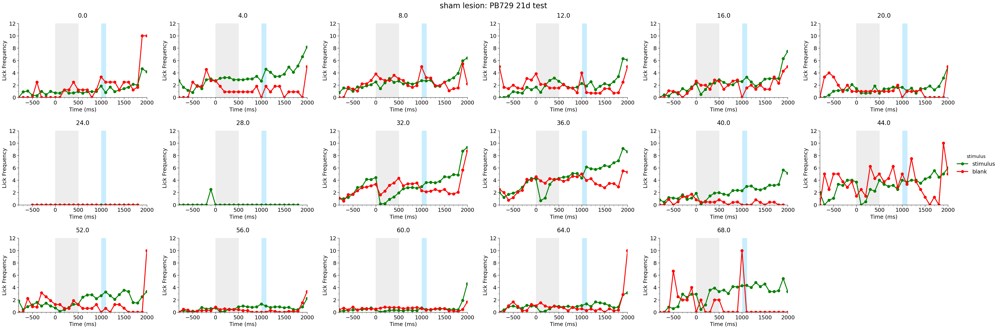

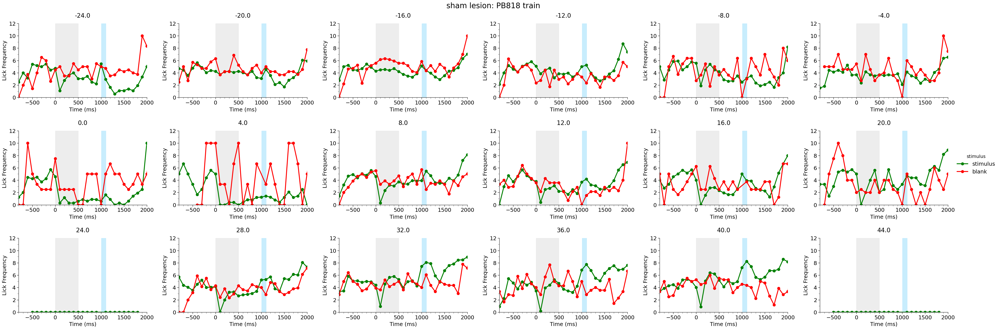

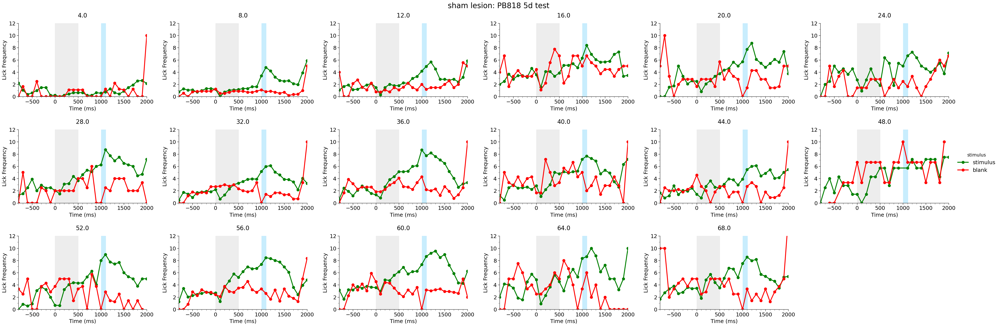

In [38]:
for a in means_full[(means_full['cond'] == c)]['animal'].unique():
    for tt in means_full[(means_full['cond'] == c)]['test_time'].unique():    
        plot_lickfreq(means_full[(means_full['animal'] == a) & (means_full['test_time'] == tt)], suptitle=f'{c}: {a} {tt}',
                    col_wrap=6,errorbar='se', err_style='bars', err_kws={'lw':0.7}, xlim=[-800, 2000])

### Anticipatory lick frequency by animal

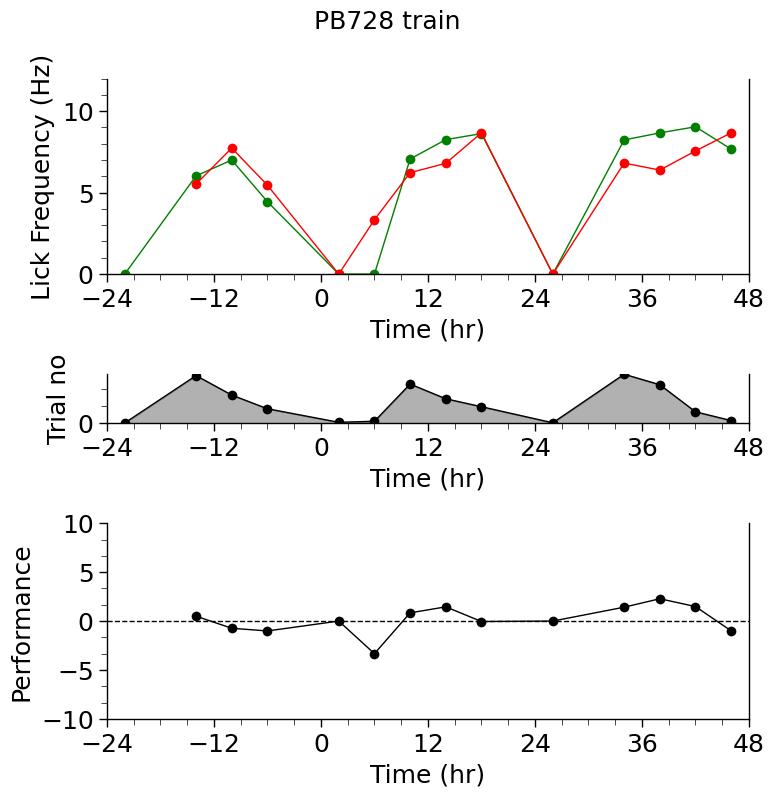

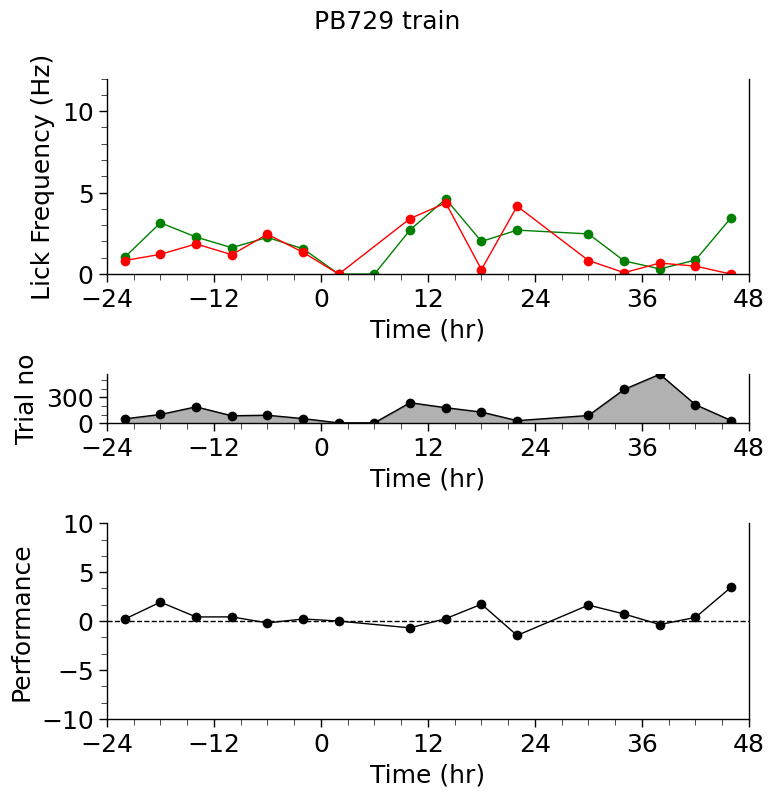

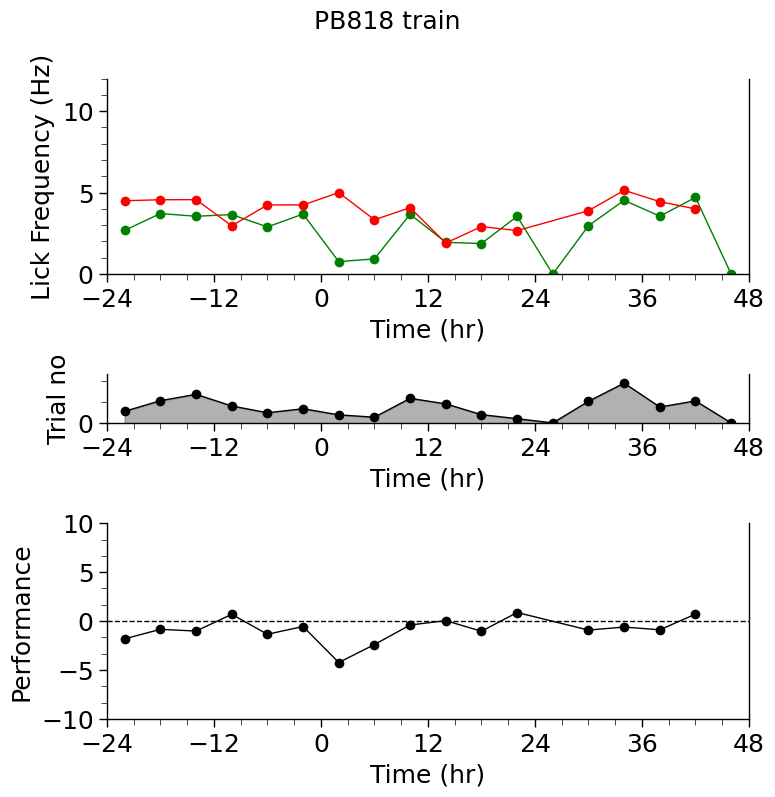

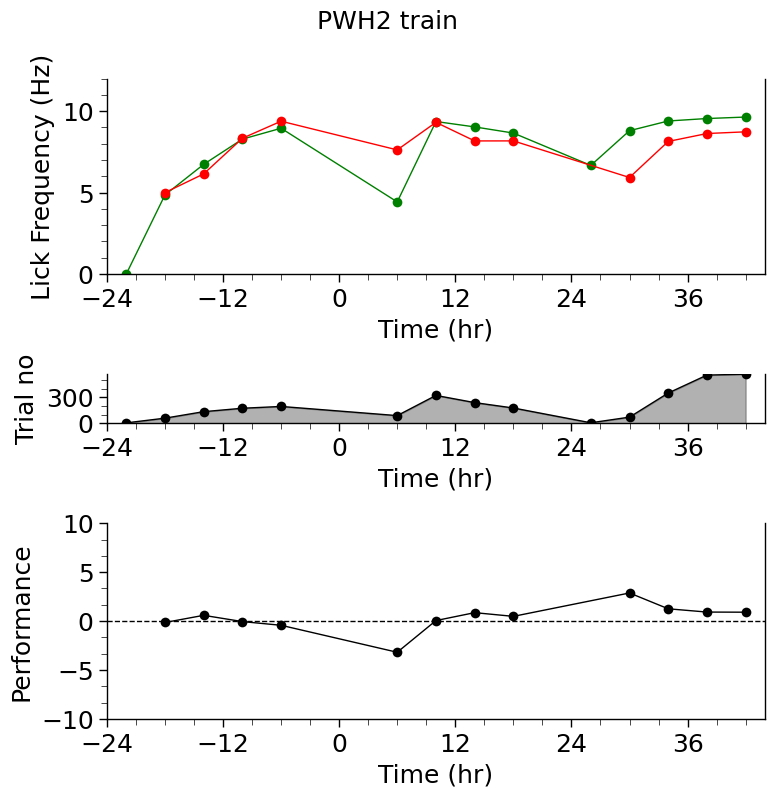

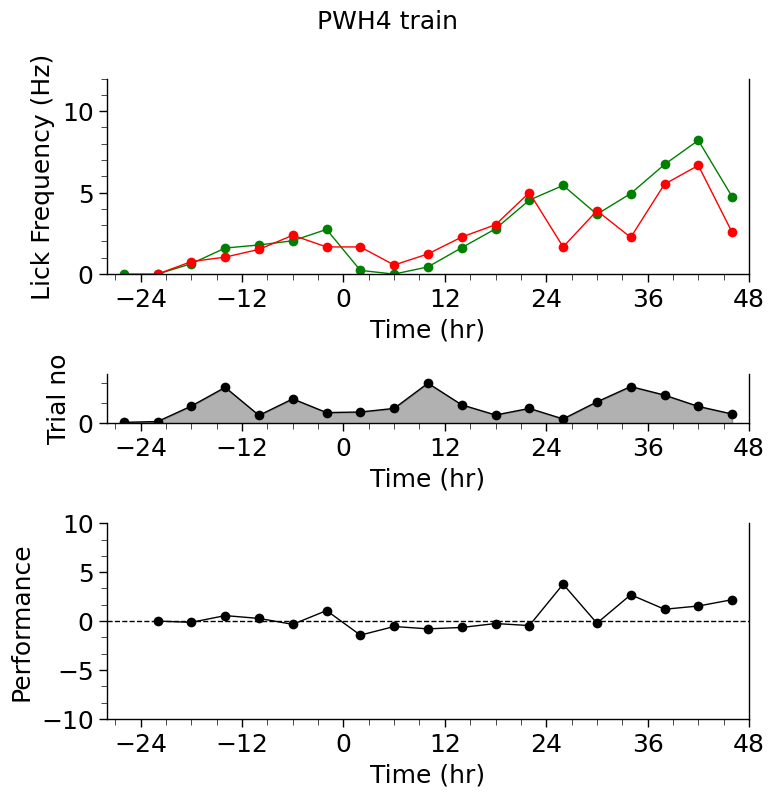

...

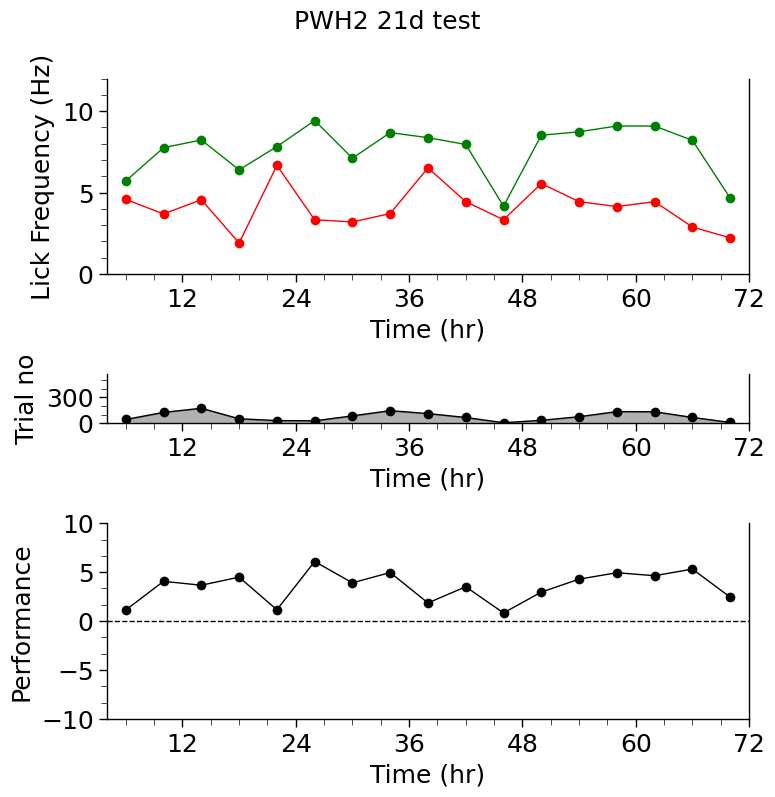

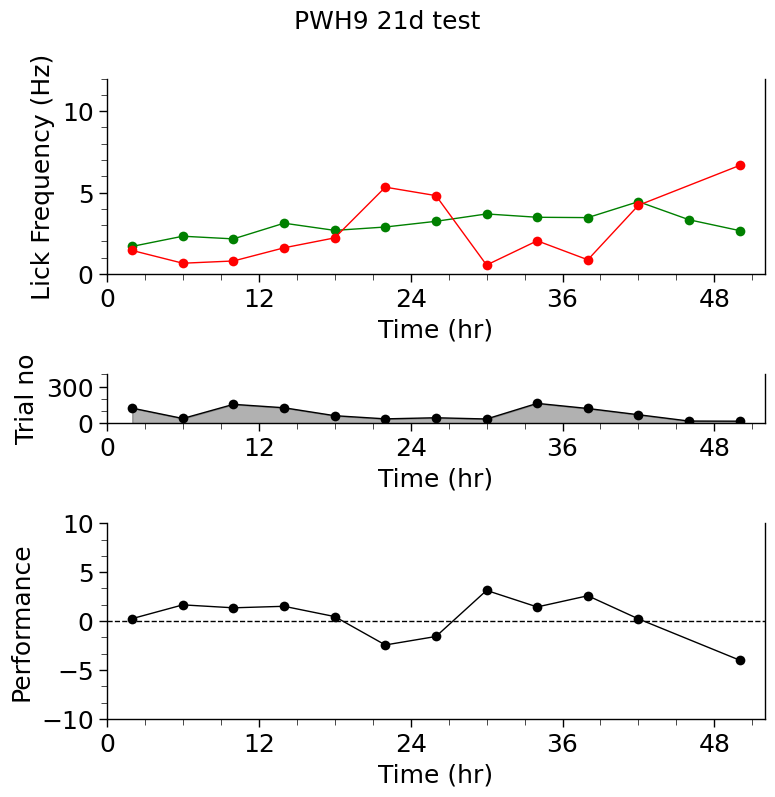

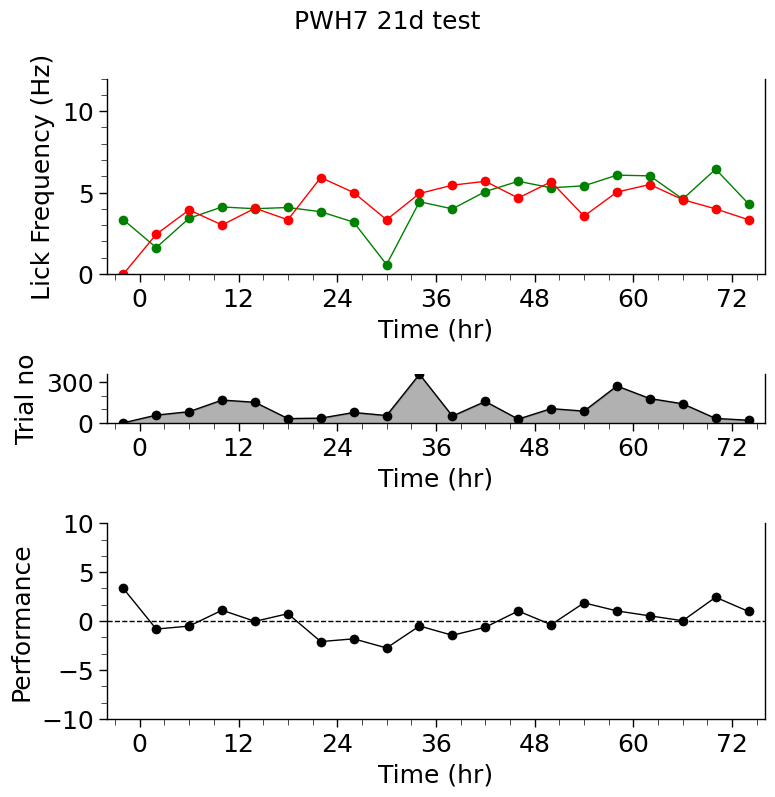

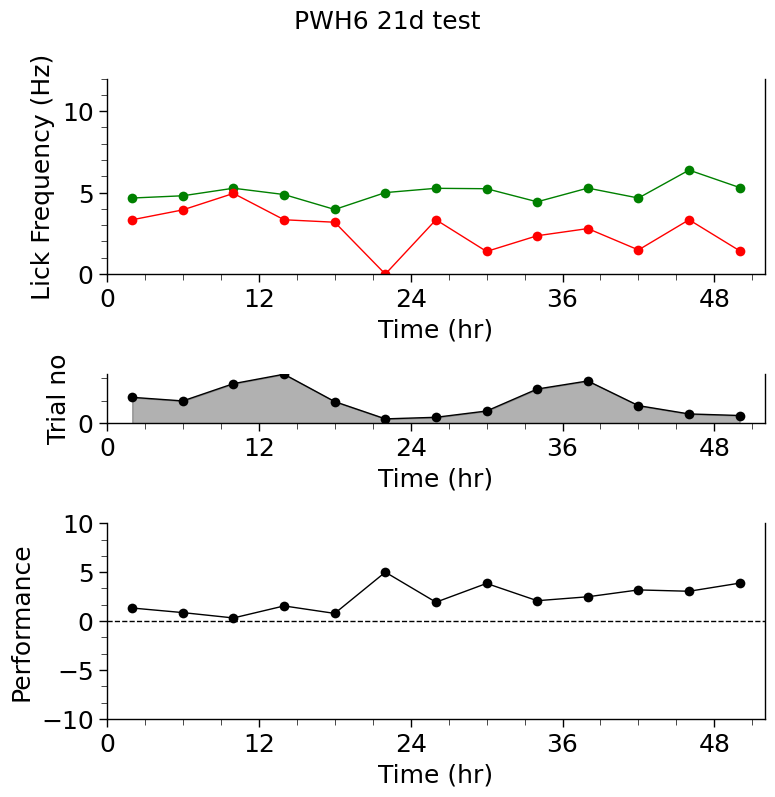

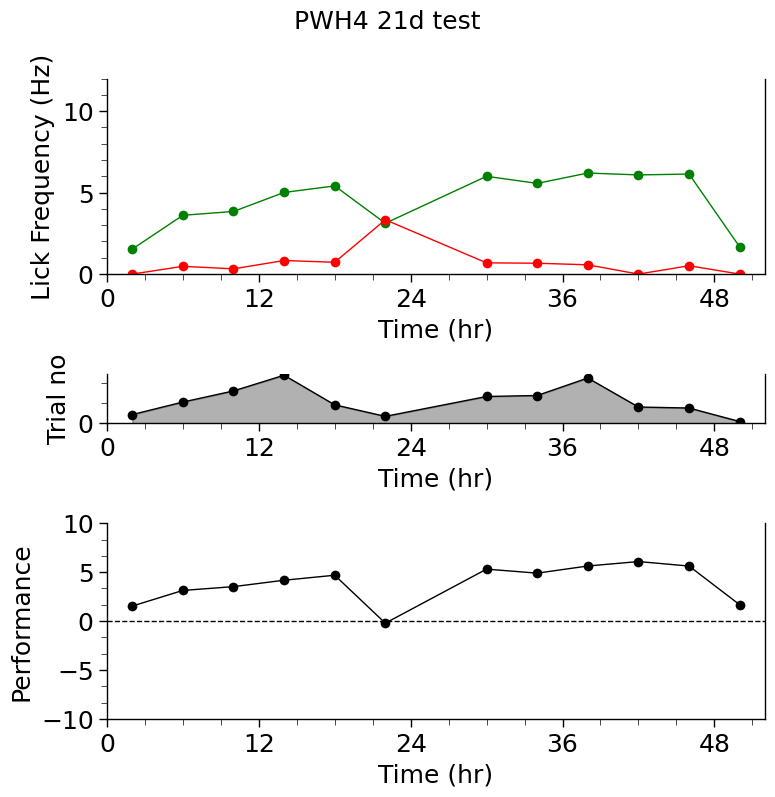

In [43]:
xlim=[-24, 48]
ctmp = ant_means[ant_means['cond'] == 'sham lesion']
for tt in ctmp['test_time'].unique():
    tmp = ctmp[ctmp['test_time'] == tt]
    for a in tmp["animal"].unique():
        xlim = [tmp[(tmp["animal"] == a)]["Time (hr)"].min() - 2, tmp[(tmp["animal"] == a)]["Time (hr)"].max() + 2]
        fg, axs = plt.subplots(3,1, height_ratios=[4,1,4], figsize=(8, 8))
        g = sns.lineplot(tmp[(tmp["animal"] == a)],x='Time (hr)',y='lick',linewidth=1, marker='o', mew=0,markersize=7, ax=axs[0],
                legend=False, errorbar='se', err_style='bars', err_kws={"lw":0.5}, hue='stimulus', hue_order=['stimulus', 'blank'],palette=['green', 'red'])
        g = sns.lineplot(ant_perf[(ant_perf["animal"] == a) & (ant_perf['test_time'] == tt)], y='lick',x='Time (hr)',lw=1,marker='o', mew=0, ms=7,ax=axs[2],
                        legend=False,errorbar='se', err_style='bars', err_kws={"lw":0.5}, color='k')
        g = sns.lineplot(tots[(tots["animal"] == a) & (tots['test_time'] == tt)],x='Time (hr)',y='trial no',ax=axs[1],marker='o', mew=0,
                            ms=7, lw=1,err_kws={"lw":0.5}, color='k')
        
        axs[0].set_ylim([0, 12])
        ymal = ticker.MultipleLocator(5)
        ymil = ticker.MultipleLocator(1)
        axs[0].yaxis.set_major_locator(ymal)
        axs[0].yaxis.set_minor_locator(ymil)
        axs[0].set_ylim([0, 12])
        axs[2].set_ylim([-10, 10])
        ymal = ticker.MultipleLocator(5)
        ymil = ticker.MultipleLocator(5/3)
        axs[2].yaxis.set_major_locator(ymal)
        axs[2].yaxis.set_minor_locator(ymil)
        
        ytrialmax = tots[tots['animal'] == a]['trial no'].max()
        axs[1].set_ylim([0, ytrialmax])
        ymal = ticker.MultipleLocator(300)
        ymil = ticker.MultipleLocator(100)
        axs[1].yaxis.set_major_locator(ymal)
        axs[1].yaxis.set_minor_locator(ymil)

        fg.suptitle(a + ' ' + tt, y=1)
        for ax in axs:
            xmajlocator = ticker.MultipleLocator(12)
            xminlocator = ticker.MultipleLocator(3)
            style_axes_helper(ax, '', 'Time (hr)', '', xlim, ax.get_ylim(), xmajlocator, xminlocator, None,None)

        axs[0].set_ylabel('Lick Frequency (Hz)')
        axs[2].set_ylabel('Performance')
        axs[1].set_ylabel("Trial no")
        axs[1].fill_between(axs[1].lines[0].get_data()[0], axs[1].lines[0].get_data()[1], 
                    color='k', alpha=0.3)
        axs[2].axhline(y=0, xmin=0, xmax=1, ls="--", color="black", zorder=10, lw=1)
        fg.tight_layout()

## Last + First 20% significance

In [44]:
res = []
firstlast20_means = firstlast20_means.sort_values(['condition', 'animal', 'daytimetest'])

stimcond = firstlast20_means["stimulus"] == "stimulus"
blankcond = firstlast20_means["stimulus"] == "blank"

conds = ['control', 'contra lesion', 'sham lesion', 'ipsi lesion']
days = ['ACC 0 last 20% train', 'SAT 2 last 20% train', f'SAT 1 first 20% 5d test', f'SAT 2 last 20% 5d test', f'SAT 1 first 20% 21d test', f'SAT 2 last 20% 21d test']
filt = (firstlast20_means.apply(lambda x: x['cond'] in conds, axis=1)) & (firstlast20_means.apply(lambda x: x['daytimetest'] in days, axis=1))
ind = firstlast20_means[filt][["cond", "daytimetest"]].apply(tuple, axis=1).unique()

for c, day in ind:
    daycond = firstlast20_means["daytimetest"] == day
    ccond = firstlast20_means["cond"] == c
    #print(firstlast20_means[daycond])
    stim = firstlast20_means[stimcond & daycond & ccond]["lick"]
    san = firstlast20_means[stimcond & daycond & ccond][['animal',"lick"]]
    blank = firstlast20_means[blankcond & daycond & ccond]["lick"]
    ban = firstlast20_means[blankcond & daycond & ccond][['animal',"lick"]]
    #print(day, c,'stim', san,'blank', ban, '\n')
    res.append(stats.wilcoxon(stim, blank))

pd.DataFrame(res, columns=["statistic", "pvalue"], index=pd.Series(ind).apply(lambda x: x[0] + ", " + x[1]))

,statistic,pvalue
"contra lesion, SAT 1 first 20% 5d test",16.0,0.275391
"contra lesion, SAT 2 last 20% 5d test",3.0,0.009766
"contra lesion, SAT 1 first 20% 21d test",19.0,0.240234
"contra lesion, SAT 2 last 20% 21d test",6.0,0.013672
"contra lesion, SAT 2 last 20% train",13.0,0.083008
"contra lesion, ACC 0 last 20% train",17.0,0.570312
"control, SAT 1 first 20% 5d test",16.0,0.077148
"control, SAT 2 last 20% 5d test",11.0,0.026855
"control, SAT 1 first 20% 21d test",4.0,0.013672
"control, SAT 2 last 20% 21d test",0.0,0.003906


## Water consumption

In [45]:
water_drank_data = pd.read_excel(r'C:\Users\swind\Documents\lab_work\Barth\behavior_analysis\behavior_data\retrain_metadata.xlsx').iloc[0:92, 0:20]

In [46]:
water_drank = water_drank_data.melt(id_vars=['Animal ID', 'animal', 'Sex', 'Strain', 'lesion','Cage', 'Date', 'Age', 'birth date','acc', 'droplet size'], value_vars=['water ACC', 'water SAT1', 'water SAT2'], var_name='day', value_name='water drank (mL)')
water_drank['calc droplet size (ul)'] = water_drank_data.melt(value_vars=['calc. drop ACC0', 'calc drop SAT1', 'calc drop SAT2'], var_name='day', value_name='droplet size (ul)')['droplet size (ul)']
water_drank['trial no'] = water_drank_data.melt(value_vars=['trial no ACC 0', 'trial no SAT 1', 'trial no SAT2'], var_name='day', value_name='trial no')['trial no']
water_drank['test_time'] = water_drank['Animal ID'].str.lstrip('PWBXTVEHSNL123456789 ')
water_drank = water_drank[water_drank['trial no'] >= 100]
water_drank['day'] = water_drank['day'].str.lstrip('water ')
water_drank['lesion'] = water_drank['lesion'].replace({'no': 'control', 'contra':'contra lesion', 'sham':'sham lesion', 'ipsi':'ipsi lesion'})
#water_drank['animal'] = water_drank['animal'].str.rstrip('retraintest')
water_drank['test_time'] = water_drank['test_time'].replace({'retrain':'5d test', 'test': '21d test'})

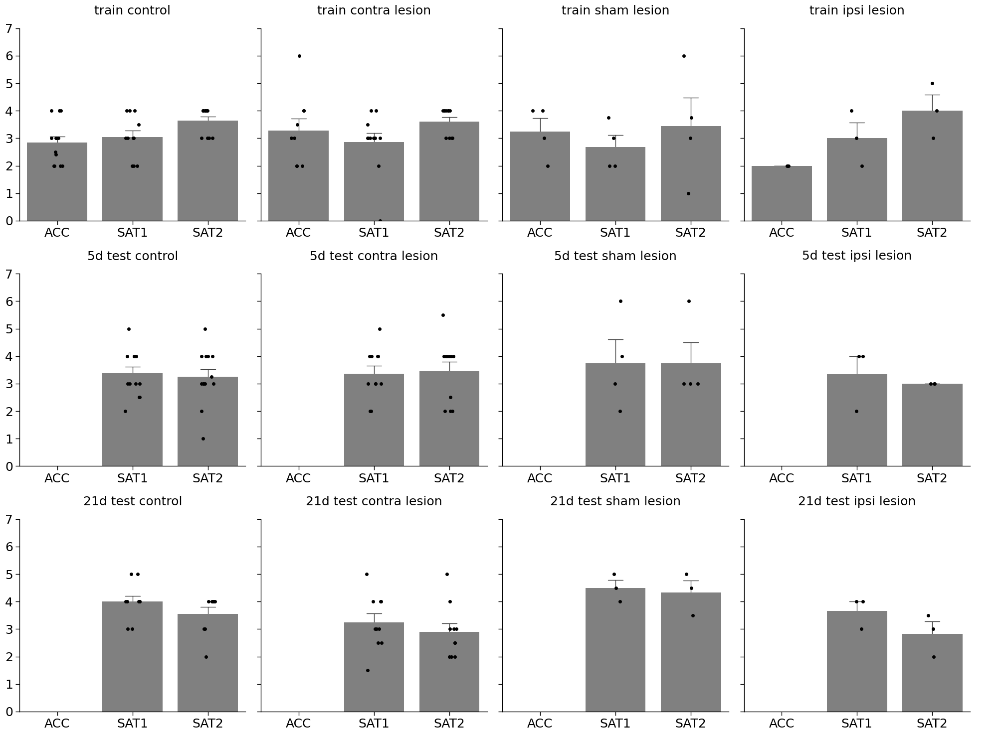

In [47]:
plot_bar_strip(water_drank, x='day', y='water drank (mL)', col='lesion',row='test_time',col_order=['control', 'contra lesion', 'sham lesion', 'ipsi lesion'],
               errorbar='se', err_kws={'lw':1, 'zorder':0}, capsize=0.2, color='grey', pt_color='k',
                ylim=[0, 7],xlim=[-0.5, 2.5], connect=False, jitter=True)

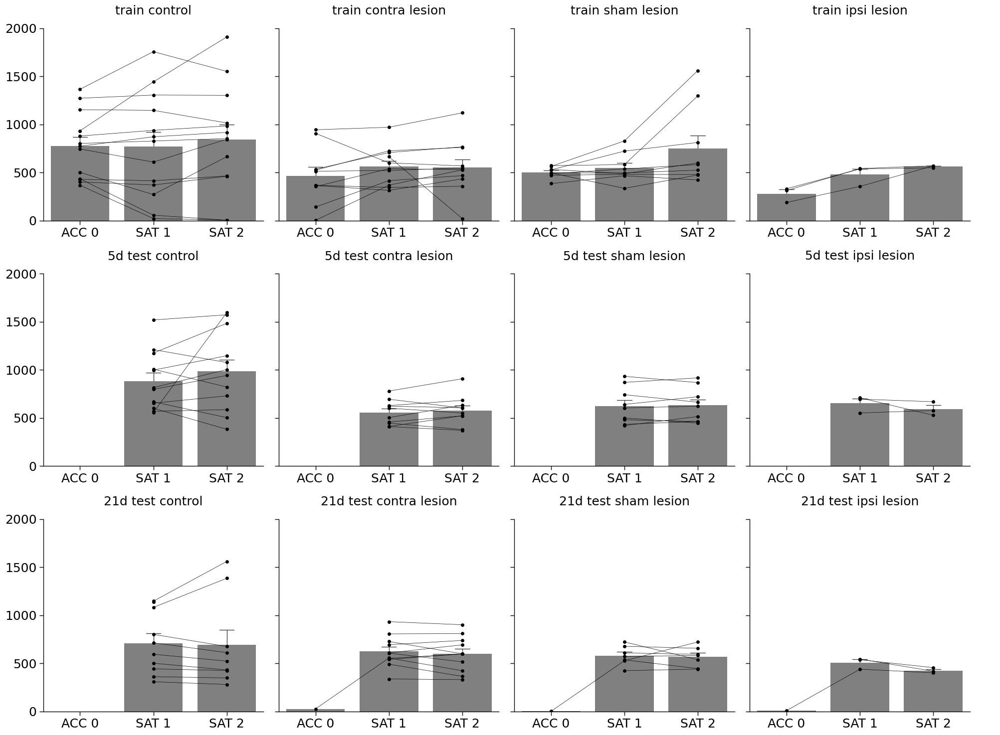

In [54]:
days = ['ACC 0', 'SAT 1', 'SAT 2']
plot_bar_strip(trials_day[(trials_day.apply(lambda x: x['Day'] in days, axis=1))],
                x='Day', y='trial no', col='cond', color='grey', pt_color='k',ylim=[0,2000],
               col_order=['control', 'contra lesion', 'sham lesion', 'ipsi lesion'],row='test_time',
               order=days, xlim=[-0.5, 2.5], connect=True)

In [82]:
trials_day['animal'] = trials_day['animal'].str.rstrip('retraintest ')
trials_day[trials_day.apply(lambda x: x['Day'] in ["ACC 0", "SAT 1", "SAT 2"], axis=1)].set_index(['cond', 'test_time','animal', 'Day'])['trial no'].unstack(level='Day').to_clipboard()

#### Cage counts by condition

In [49]:
def get_cage_counts(df, gpcols):
    counts = df.groupby(['cond', 'test_time', 'animal']).first().groupby(gpcols).count()['stimulus']
    kpcols = df.columns.drop(gpcols + ['animal', 'stimulus'])
    kp = df.groupby(gpcols)[kpcols].first()
    return pd.concat([counts, kp], axis=1).reset_index()

In [60]:
cage_counts[cage_counts['test_time'] == 'train'].set_index(['condition', 'Cage'])['stimulus'].unstack(level='Cage').to_clipboard()

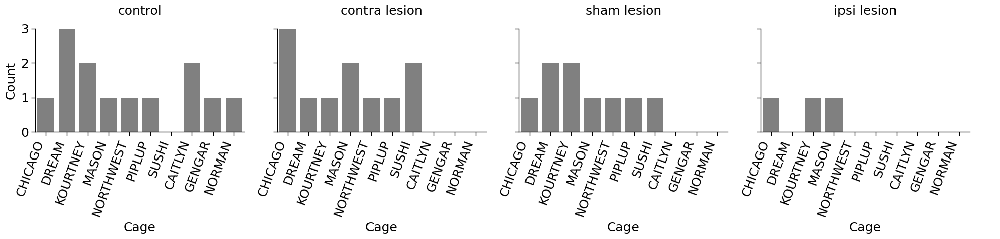

In [50]:
cage_counts = get_cage_counts(trials_day,['cond', 'test_time', 'Cage'])
conds = ['control', 'contra lesion', 'sham lesion', 'ipsi lesion']

g = sns.catplot(cage_counts[(cage_counts['test_time']=='train')
                          & (cage_counts.apply(lambda x: x['cond'] in conds, axis=1))], 
                y='stimulus', x='Cage',kind='bar', col='cond', color='grey', col_order=conds)

for name, ax in g.axes_dict.items():
    g.axes_dict[name].set_title(name)
    g.axes_dict[name].set_ylabel('Count')
    g.axes_dict[name].tick_params(labelbottom=True, labeltop=False)
    g.axes_dict[name].set_xticklabels(g.axes_dict[name].get_xticklabels(), rotation=70, ha='right')
g.tight_layout()

In [62]:
tot = trials[(trials['Time (hr)'] >= 0) & (trials['Time (hr)'] < 48)].groupby(['condition', 'animal'])['trial no'].sum()
kp = trials[(trials['Time (hr)'] >= 0) & (trials['Time (hr)'] < 48)].groupby(['condition', 'animal'])[['Age', 'Strain', 'Date', 'Cage']].first()
tot = pd.concat([tot, kp], axis=1).reset_index().rename(columns={0:'trial no'})
format_condition(tot)
tot['an'] = tot['animal']
tot['animal'] = tot['animal'].str.rstrip('retraintest ')

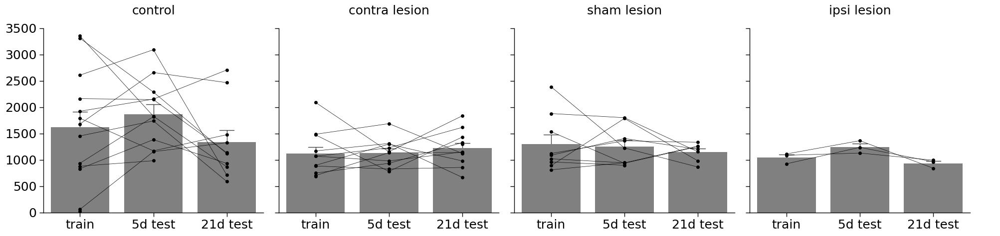

In [65]:
conds = ['control', 'contra lesion', 'sham lesion', 'ipsi lesion']
times = ['train', '5d test', '21d test']
g = plot_bar_strip(tot[(tot['cond'].str.contains(' lesion')) | (tot['cond'] == 'control')], 
                y='trial no', x='test_time', col='cond', order=times, col_order=conds,pt_color='k',connect=True,
                errorbar='se', color='grey', err_kws={'lw':1, 'zorder':0}, capsize=0.2, ylim=[0, 3500], xlim=[-0.5,2.5])

In [74]:
tot.set_index(['cond', 'animal', 'test_time'])['trial no'].unstack(level='test_time')[['train', '5d test', '21d test']].to_clipboard()

#### measured droplet size

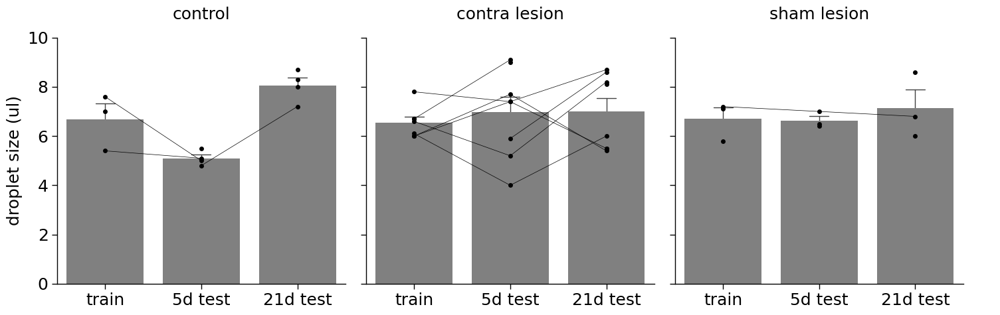

In [ ]:
g = plot_bar_strip(water_drank[water_drank['day'] == 'SAT2'], x='test_time', 
                   y='droplet size', col='lesion',col_order=['control', 'contra lesion', 'sham lesion'],
                   order=['train', '5d test', '21d test'], xlim=[-0.5, 2.5],
                   errorbar='se', color='grey', err_kws={'lw':1, 'zorder':0}, capsize=0.2,
                   ylabel='droplet size (ul)', pt_color='black', jitter=False, connect=True)